# Customer Segmentation for Marketing Campaign

**Names**: Shantanu S., Umesh K., Yash K. 

## 1. Introduction and Dataset Research

### Motivation

For this project, we aim to look at a Marketing Campaign dataset, which contains information of about the firm's customers. It includes information such as their purchases, personal data, and more importantly, their responses to the marketing campaigns.

Customer segmentation allows us to learn much more about the customers. By understanding the characteristics of a particular segment, we can tailor to each group's unique needs and challenges and be able to create targeted campaigns and advertisements that resonate with and convert certain segments of customers.

Our motivation for this project is to understand customer behaviour and identify characteristics of customers that respond to various marketing campaigns. By identifying customer segments, we can help improve revenue by understanding the targeted audience and improve marketing strategies by focusing on clusters that respond well.

**References**

- Baker, Kristen. ***“Customer Segmentation: How to Effectively Segment Users &amp; Clients.”*** HubSpot Blog. HubSpot, November 25, 2022. https://blog.hubspot.com/service/customer-segmentation. 
- Patel, Neil. ***“How to Use Customer Segmentation to Improve the Performance of Your Marketing Campaigns.”*** Neil Patel, June 7, 2022. https://neilpatel.com/blog/customer-segmentation/. 
- Alzahrani, Lama Ali. ***“Customer Segmentation: Unsupervised Machine Learning Algorithms in Python.”*** Medium. Towards Data Science, July 15, 2021. https://towardsdatascience.com/customer-segmentation-unsupervised-machine-learning-algorithms-in-python-3ae4d6cfd41d.  

### Data Description

The dataset was collected from Kaggle: https://www.kaggle.com/datasets/rodsaldanha/arketing-campaign


The dataset contains 2240 rows and 29 columns. 

- **AcceptedCmp1** - 1 if customer accepted the offer in the 1st campaign, 0 otherwise
- **AcceptedCmp2** - 1 if customer accepted the offer in the 2nd campaign, 0 otherwise
- **AcceptedCmp3** - 1 if customer accepted the offer in the 3rd campaign, 0 otherwise
- **AcceptedCmp4** - 1 if customer accepted the offer in the 4th campaign, 0 otherwise
- **AcceptedCmp5** - 1 if customer accepted the offer in the 5th campaign, 0 otherwise
- **Response** - 1 if customer accepted the offer in the last campaign, 0 otherwise
- **Complain** - 1 if customer complained in the last 2 years
- **DtCustomer** - Date of customer’s enrolment with the company
- **Education** - Customer’s level of education
- **Marital_Status** - Customer’s marital status
- **Kidhome** - Number of small children in customer’s household
- **Teenhome** - Number of teenagers in customer’s household
- **Income** - Customer’s yearly household income
- **MntFishProducts** - Amount spent on fish products in the last 2 years
- **MntMeatProducts** - Amount spent on meat products in the last 2 years
- **MntFruits** - Amount spent on fruits products in the last 2 years
- **MntSweetProducts** - Amount spent on sweet products in the last 2 years
- **MntWines** - Amount spent on wine products in the last 2 years
- **MntGoldProds** - Amount spent on gold products in the last 2 years
- **NumDealsPurchases** - Number of purchases made with discount
- **NumCatalogPurchases** - Number of purchases made using catalogue
- **NumStorePurchases** - Number of purchases made directly in stores
- **NumWebPurchases** - Number of purchases made through company’s web site
- **NumWebVisitsMonth** - Number of visits to company’s web site in the last month
- **Recency** - Number of days since the last purchase
- **ID** - Customer's ID
- **Year_Birth** - Customer's year of birth
- **Z_CostContact** - Cost to contact a customer
- **Z_Revenue** - Revenue after client accepting campaign 

## 2. Data Cleaning and Data Manipulation

We first import the necessary modules required for the project.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
import matplotlib.cm as cm
from datetime import timedelta

from pyclustertend import hopkins
from gower import gower_matrix
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
from sklearn import preprocessing
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
from kmodes.kprototypes import KPrototypes
from sklearn.metrics import silhouette_samples, silhouette_score
from scipy.linalg import block_diag
from sklearn.metrics import calinski_harabasz_score
from skfuzzy.cluster import cmeans

import warnings
warnings.filterwarnings('ignore')

After importing, we now begin by reading the dataset into a dataframe.

In [2]:
df = pd.read_csv('marketing_campaign.csv', sep = ";")
df.shape

(2240, 29)

We then check if there are any missing values in the dataset.

In [3]:
df.isnull().sum()

ID                      0
Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Z_CostContact           0
Z_Revenue               0
Response                0
dtype: int64

Since only one column has missing values, and it is nearly 1% of the dataset, we decided to drop those rows.

In [4]:
df = df.dropna().reset_index(drop=True)

We now check if there are any columns that need further cleaning.

In [5]:
df.Marital_Status.value_counts()

Married     857
Together    573
Single      471
Divorced    232
Widow        76
Alone         3
Absurd        2
YOLO          2
Name: Marital_Status, dtype: int64

We see that the categories in this column has some redunancy, since a lot of them mean the same thing. So, we reassign the categories correctly.

In [6]:
df['Marital_Status'] = df.Marital_Status.replace({
    'Divorced':'Divorced/Widow', 'Widow':'Divorced/Widow', 
    'Alone':'Unmarried', 'Single':'Unmarried', 'Absurd':'Unmarried', 'YOLO':'Unmarried',
    'Together':'Married'})

We also check other columns.

In [7]:
df.Education.value_counts()

Graduation    1116
PhD            481
Master         365
2n Cycle       200
Basic           54
Name: Education, dtype: int64

We do the same for ```Education``` as well.

In [8]:
df['Education'] = df.Education.replace({
    'Basic':'UG', '2n Cycle':'UG', 
    'Master':'PG', 'PhD':'PG'})

Now, we rename a few columns for ease of presentation

In [9]:
df = df.rename(
    columns={"MntWines": "Wines", "MntFruits":"Fruits", "MntMeatProducts":"Meat", "MntFishProducts":"Fish",
             "MntSweetProducts":"Sweet", "MntGoldProds":"Gold", "Response":"AcceptedCmp6"}
)

Next, we change the column type of ```Dt_Customer``` to datetime.

In [10]:
df['Dt_Customer'] = pd.to_datetime(df.Dt_Customer)

Now, we add a few columns that we feel could be useful in our analysis.

In [11]:
# We consider the today date to be the year when this dataset was made available on Kaggle for an accurate analysis.
today = datetime.datetime(2015,1,1)

# Calculate the number of days the customer has been enrolled with the company.
df['Enrolled_Days'] = (today - df.Dt_Customer).dt.days
# This would allow us to drop the datetime column in favor of this column.

# Calculate the age of customer based on their birth year.
df['Age'] = today.year - df.Year_Birth

# Calculate the total children of customer.
df['Children'] = df.Kidhome + df.Teenhome

# Calculate the total amount spent on purchases.
df['Total_Spent'] = df.Wines + df.Fruits + df.Meat + df.Fish + df.Sweet + df.Gold

# Calculate the total purchases.
df['Total_Purchases'] = df.NumDealsPurchases + df.NumWebPurchases + df.NumCatalogPurchases + df.NumStorePurchases

Now, we drop columnns which are redundant or not useful.

In [12]:
df = df.drop(columns = ['ID', 'Year_Birth', 'Dt_Customer', 'Z_CostContact', 'Z_Revenue'])
df.head()

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,Wines,Fruits,Meat,Fish,...,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,AcceptedCmp6,Enrolled_Days,Age,Children,Total_Spent,Total_Purchases
0,Graduation,Unmarried,58138.0,0,0,58,635,88,546,172,...,0,0,0,0,1,849,58,0,1617,25
1,Graduation,Unmarried,46344.0,1,1,38,11,1,6,2,...,0,0,0,0,0,299,61,2,27,6
2,Graduation,Married,71613.0,0,0,26,426,49,127,111,...,0,0,0,0,0,498,50,0,776,21
3,Graduation,Married,26646.0,1,0,26,11,4,20,10,...,0,0,0,0,0,325,31,1,53,8
4,PG,Married,58293.0,1,0,94,173,43,118,46,...,0,0,0,0,0,347,34,1,422,19


We also change the dtypes of certain columns, which we believe are more suited as categorical.

In [13]:
for c in ['AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp6', 'Complain']:
    df[c] = df[c].apply(lambda x: 'Yes' if x==1 else 'No')

We also noticed that there is one outlier in ```Income```, so we remove that observation.

<AxesSubplot:ylabel='Income'>

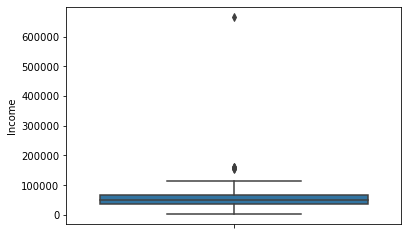

In [14]:
sns.boxplot(y = 'Income', data = df)

In [15]:
df = df.loc[df.Income<300000].reset_index(drop=True)

## 3. Basic Descriptive Analytics

We now begin a descriptive analysis of our dataset.

In [16]:
df.shape

(2215, 29)

After cleaning our data, we are left with 2215 rows and 28 columns.

In [17]:
df.describe()

,Income,Kidhome,Teenhome,Recency,Wines,Fruits,Meat,Fish,Sweet,Gold,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Enrolled_Days,Age,Children,Total_Spent,Total_Purchases
count,2215.000000,2215.000000,2215.000000,2215.000000,2215.000000,2215.000000,2215.000000,2215.000000,2215.000000,2215.000000,2215.000000,2215.000000,2215.000000,2215.000000,2215.000000,2215.000000,2215.000000,2215.000000,2215.000000,2215.000000
mean,51969.861400,0.441535,0.505643,49.024379,305.225282,26.361625,167.063205,37.651016,27.040632,43.979684,2.322799,4.085779,2.671783,5.802257,5.318736,539.503837,46.183296,0.947178,607.321445,14.882619
std,21526.320095,0.536886,0.544198,28.949608,337.345380,39.802036,224.311559,54.760822,41.077594,51.822660,1.923820,2.741473,2.927179,3.250974,2.425863,202.478727,11.987000,0.749230,602.925291,7.672246
min,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,186.000000,19.000000,0.000000,5.000000,0.000000
25%,35284.000000,0.000000,0.000000,24.000000,24.000000,2.000000,16.000000,3.000000,1.000000,9.000000,1.000000,2.000000,0.000000,3.000000,3.000000,366.000000,38.000000,0.000000,69.000000,8.000000
50%,51373.000000,0.000000,0.000000,49.000000,175.000000,8.000000,68.000000,12.000000,8.000000,25.000000,2.000000,4.000000,2.000000,5.000000,6.000000,541.000000,45.000000,1.000000,397.000000,15.000000
75%,68487.000000,1.000000,1.000000,74.000000,505.000000,33.000000,232.500000,50.000000,33.000000,56.000000,3.000000,6.000000,4.000000,8.000000,7.000000,715.000000,56.000000,1.000000,1048.000000,21.000000
max,162397.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,259.000000,262.000000,321.000000,15.000000,27.000000,28.000000,13.000000,20.000000,885.000000,122.000000,3.000000,2525.000000,44.000000


We see that columns like ```Income```, ```Wines```, ```Meat```, ```Enrolled_Days```, and ```Total_Spent``` have a very high variance. Thus, it would make sense for us to scale these later.

We also see that, on average, customers spend more on Wines and Meat than other products. The average age of customers is also on the higher end.

In [18]:
cat_cols = ['Education', 'Marital_Status', 'AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp6', 'Complain']
num_cols = set(df.columns).difference(set(cat_cols))

We now look at histograms of the categorical columns.

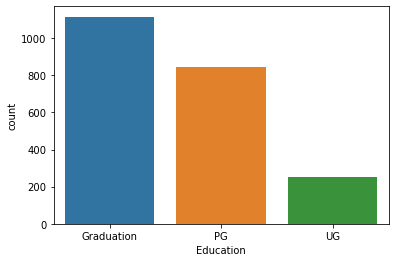

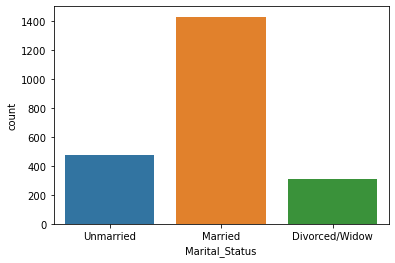

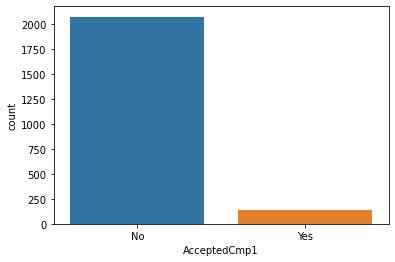

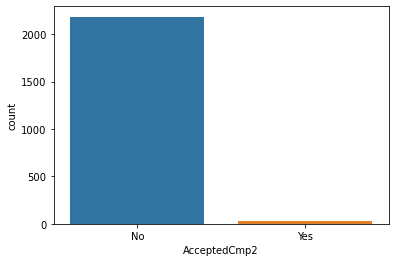

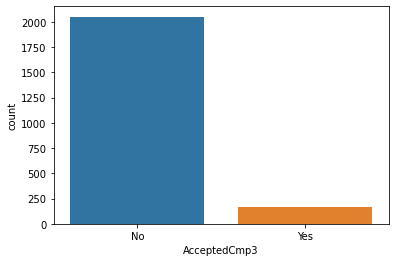

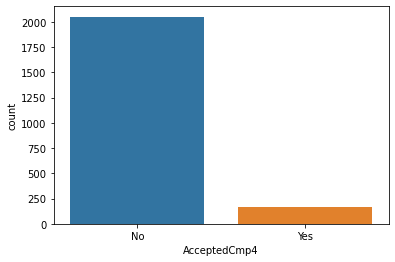

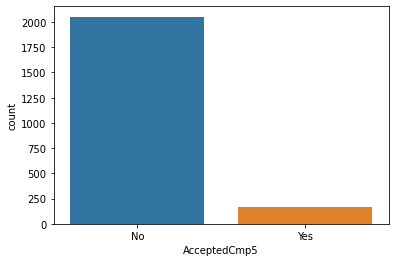

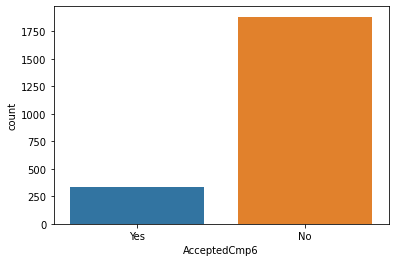

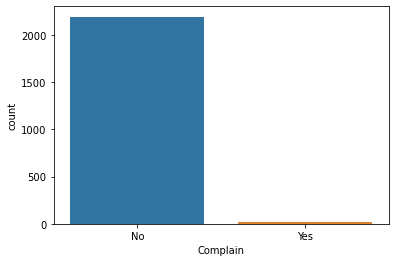

In [19]:
for col in cat_cols:
    sns.countplot(x = col, data = df)
    plt.show()

We see that most of the customers have atleast a Bachlor's degree. A significant portion also have done postgraduation.

A siginficant majority of the customers are also married.

For the campaign responses, we see that not many customers respond well to the campaigns. We see around 250 people responding to campaigns everytime, except for Campaign 2, which had an abysmally low response.

On a postive note, the number of customers who have complained are alse very low.

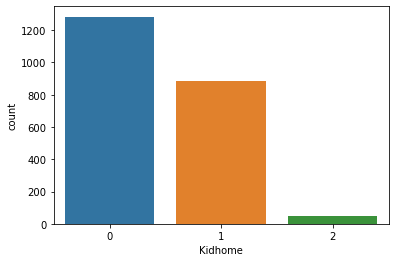

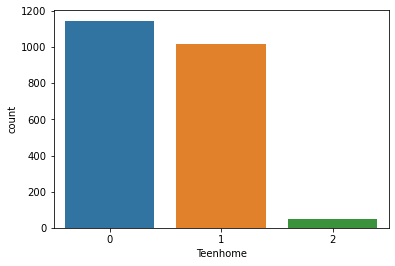

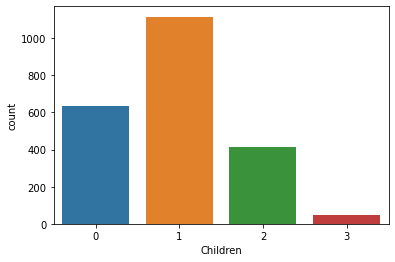

In [20]:
for col in ['Kidhome', 'Teenhome', 'Children']:
    sns.countplot(x = col, data = df)
    plt.show()

From the aabove histograms, we see that more than half of the customers have atleast one or more children (could be either kids or teens).

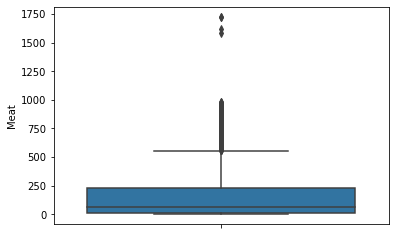

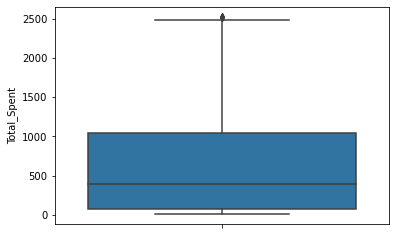

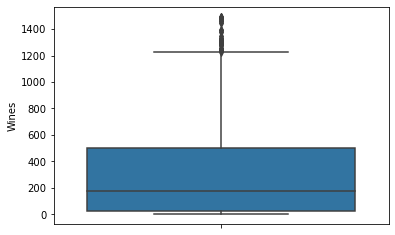

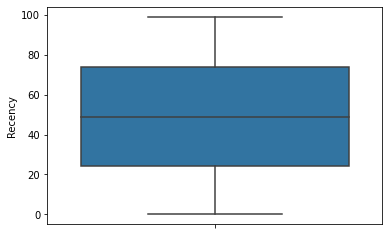

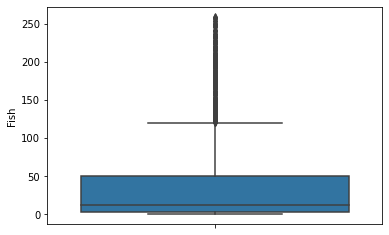

...

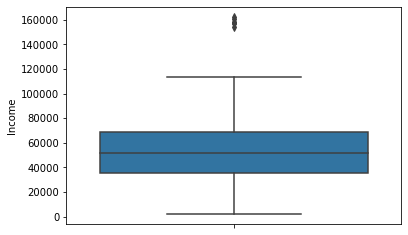

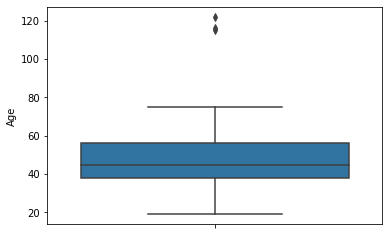

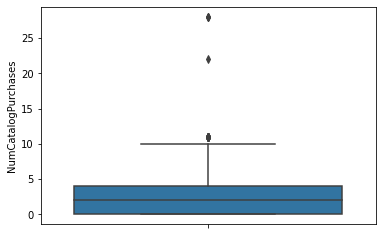

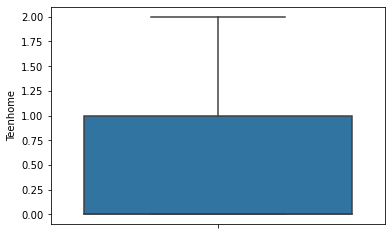

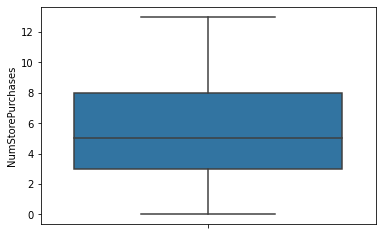

In [21]:
for col in num_cols:
    sns.boxplot(y = col, data = df)
    plt.show()

We see that a lot of the customer spend more than the average on products like Sweet, Fruits, and Meat. It would be interesting to see if this is related to the customer's Income or Age. 

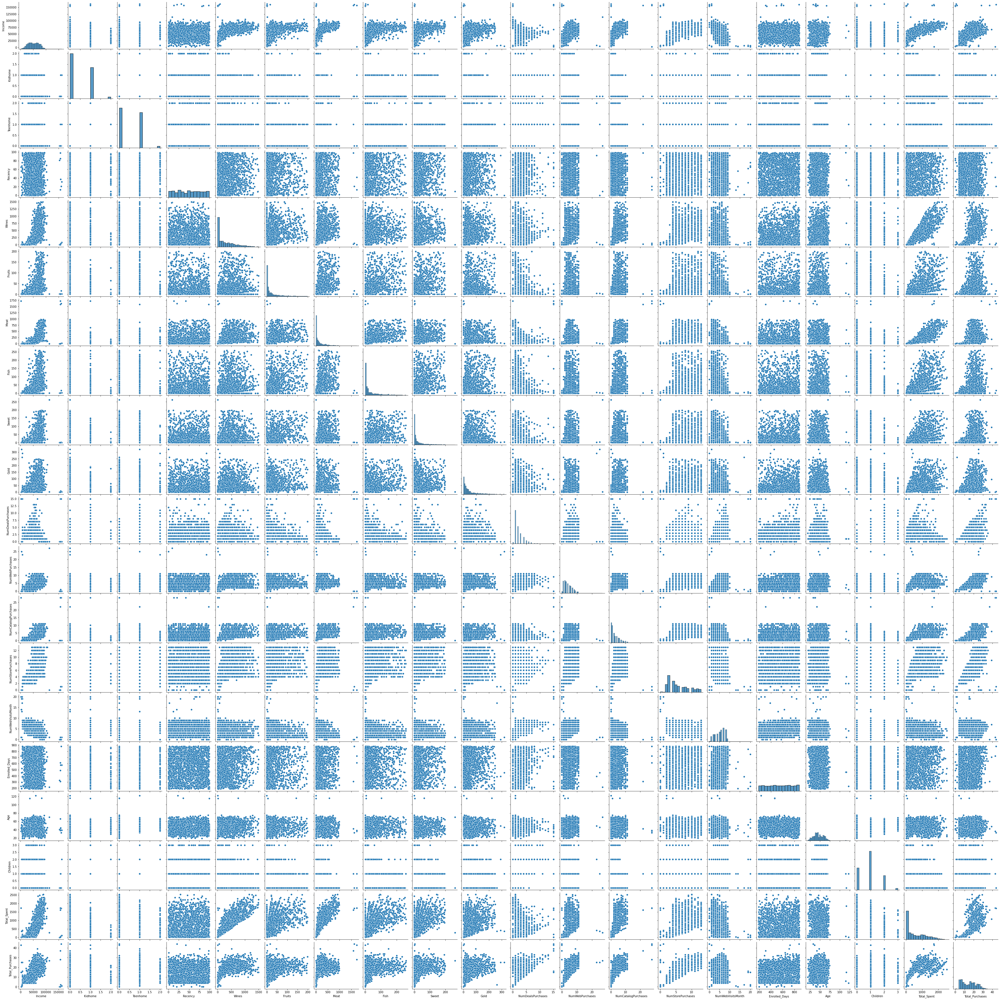

In [22]:
sns.pairplot(df)
plt.show()

From the above pairplot, it becomes difficult to see the important relationships, so we focus only on columns that we believe could be useful.

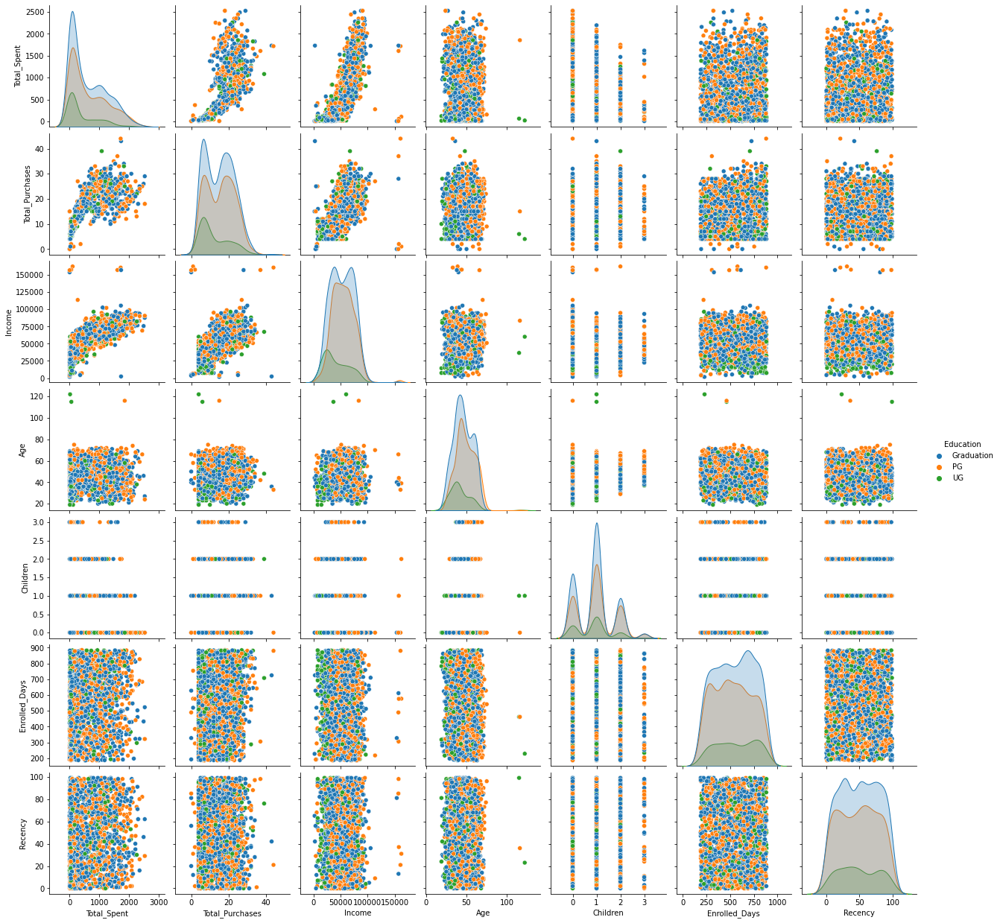

In [23]:
sns.pairplot(df[['Total_Spent', 'Total_Purchases', 'Income', 'Age', 'Children', 'Enrolled_Days', 'Recency', 'Education']],
            hue = 'Education')
plt.show()

We see that there is a clear relationship between ```Income``` and ```Total_Spent```

## 4. Dataset Scaling Decisions

As mentioned above, we want to scale the numerical columns since they have a high variance, which could affect our algorithm's performance.

In [24]:
df_num = df[num_cols].copy()
scaler = StandardScaler()
df_scaled = pd.DataFrame(scaler.fit_transform(df_num), columns = df_num.columns)
df_scaled.head()

,Meat,Total_Spent,Wines,Recency,Fish,Gold,Sweet,NumWebVisitsMonth,Total_Purchases,NumWebPurchases,Enrolled_Days,Children,NumDealsPurchases,Kidhome,Fruits,Income,Age,NumCatalogPurchases,Teenhome,NumStorePurchases
0,1.689714,1.675011,0.977779,0.310113,2.453932,0.849633,1.484340,0.693215,1.318997,1.428103,1.528882,-1.264487,0.352088,-0.822585,1.548973,0.286604,0.986016,2.504074,-0.929363,-0.554500
1,-0.718196,-0.962727,-0.872375,-0.380899,-0.651178,-0.733043,-0.634081,-0.131420,-1.158021,-1.125846,-1.188066,1.405522,-0.167829,1.040427,-0.637338,-0.261407,1.236344,-0.571253,0.908618,-1.169839
2,-0.178646,0.279830,0.358096,-0.795506,1.339745,-0.038210,-0.147087,-0.543738,0.797519,1.428103,-0.205025,-1.264487,-0.687745,-0.822585,0.568903,0.912723,0.318476,-0.229550,-0.929363,1.291518
3,-0.655768,-0.919594,-0.872375,-0.795506,-0.505056,-0.752344,-0.585381,0.280897,-0.897283,-0.760996,-1.059629,0.070517,-0.167829,1.040427,-0.561948,-1.176680,-1.266933,-0.912956,-0.929363,-0.554500
4,-0.218777,-0.307440,-0.392047,1.553934,0.152497,-0.559335,-0.000989,-0.131420,0.536780,0.333553,-0.950951,0.070517,1.391921,1.040427,0.418123,0.293806,-1.016605,0.112153,-0.929363,0.060839


## 5. Clusterability and Clustering Structure Questions

We check for clusterability using Hopkins Statistic on the numerical data and TSNE on the entire dataset.

In [25]:
num_of_trials = 5
hopkins_statistics = []
for i in range(0, num_of_trials):
    n = len(df_scaled)
    p = int(0.1 * n)
    hopkins_statistics.append(hopkins(df_scaled, p))
print(hopkins_statistics)
print(np.mean(hopkins_statistics))

[0.13412636562346147, 0.14605955812585222, 0.15017018106121924, 0.14210916945171875, 0.1441712537663617]
0.1433273056057227


We see that the Hopkins Statistic is 0.14. Since this measure is closer to 0 than to 0.5, it indicates that the dataset is clusterable.

Since we have mixed data, we need to create a distance matrix which will be used in TSNE plot. For the numerical columns, we use the previously scaled dataset.

In [26]:
num_dist = squareform(pdist(df_scaled))**2

For the categorical columns, we first perform label encoding, and then using hamming distance, create the categorical distance matrix.

In [27]:
X_cat = df[cat_cols].copy()
label_enc = {}
for col in X_cat.columns:
    label_enc[col] = preprocessing.LabelEncoder()
    X_cat[col] = label_enc[col].fit_transform(X_cat[col])

In [28]:
cat_dist = squareform(pdist(X_cat, metric = 'hamming')*len(X_cat.columns))

In [29]:
df_label_enc = pd.concat([df_scaled, X_cat], axis = 1)
X = pd.concat([df_scaled, df[cat_cols]], axis = 1)

Now, we choose an appropriate gamma value. For this, we look at multiple elbow plots for different gamma values. We will choose the gamma that gives the least cost.

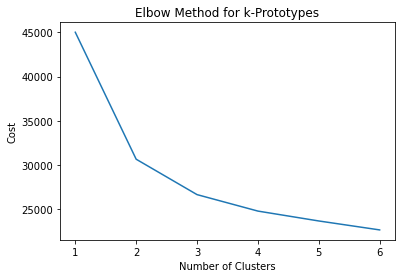

In [30]:
cost = []
for num_clusters in list(range(1, 7)):
    kp = KPrototypes(n_clusters = num_clusters, gamma = 0.25, random_state = 100)
    kp.fit_predict(X, categorical = [20, 21, 22, 23, 24, 25, 26, 27, 28])
    cost.append(kp.cost_)
    
plt.plot(list(range(1, 7)), cost)
plt.xlabel('Number of Clusters')
plt.ylabel('Cost')
plt.title('Elbow Method for k-Prototypes')
plt.show()

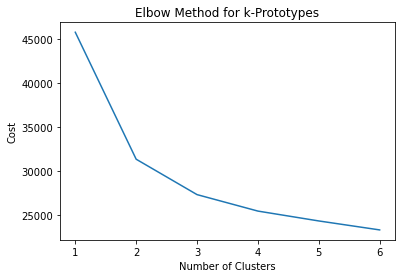

In [31]:
cost = []
for num_clusters in list(range(1, 7)):
    kp = KPrototypes(n_clusters = num_clusters, gamma = 0.5, random_state = 100)
    kp.fit_predict(X, categorical = [20, 21, 22, 23, 24, 25, 26, 27, 28])
    cost.append(kp.cost_)

plt.plot(list(range(1, 7)), cost)
plt.xlabel('Number of Clusters')
plt.ylabel('Cost')
plt.title('Elbow Method for k-Prototypes')
plt.show()

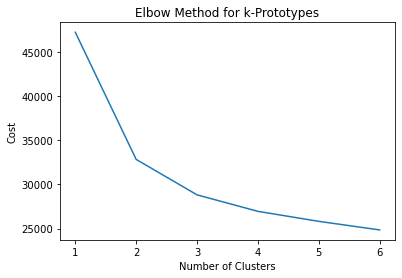

In [32]:
cost = []
for num_clusters in list(range(1, 7)):
    kp = KPrototypes(n_clusters = num_clusters, gamma = 1, random_state = 100)
    kp.fit_predict(X, categorical = [20, 21, 22, 23, 24, 25, 26, 27, 28])
    cost.append(kp.cost_)

plt.plot(list(range(1, 7)), cost)
plt.xlabel('Number of Clusters')
plt.ylabel('Cost')
plt.title('Elbow Method for k-Prototypes')
plt.show()

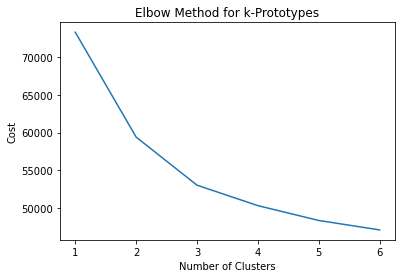

In [33]:
cost = []
for num_clusters in list(range(1, 7)):
    kp = KPrototypes(n_clusters = num_clusters, gamma = 10, random_state = 100)
    kp.fit_predict(X, categorical = [20, 21, 22, 23, 24, 25, 26, 27, 28])
    cost.append(kp.cost_)

plt.plot(list(range(1, 7)), cost)
plt.xlabel('Number of Clusters')
plt.ylabel('Cost')
plt.title('Elbow Method for k-Prototypes')
plt.show()

From the elbow plots, we see that the least cost occurs at $\gamma = 0.25$. 

In [34]:
gamma = 0.25
final_dist_mat = num_dist + (gamma*cat_dist)

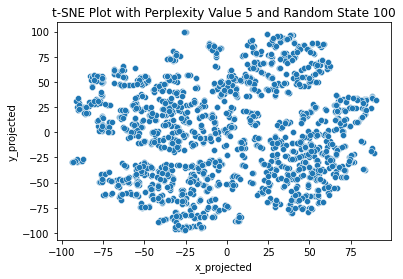

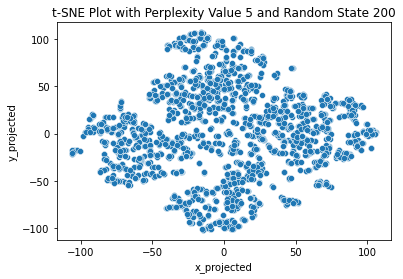

--------------------------------------------


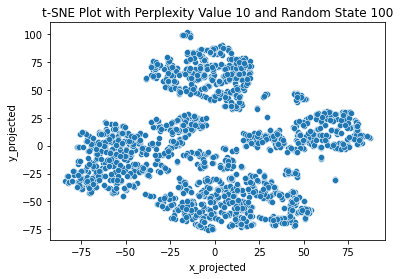

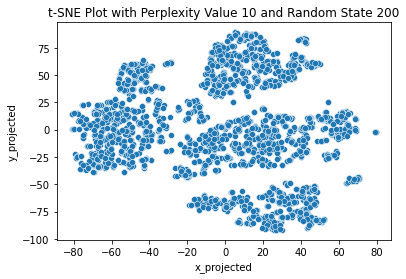

--------------------------------------------


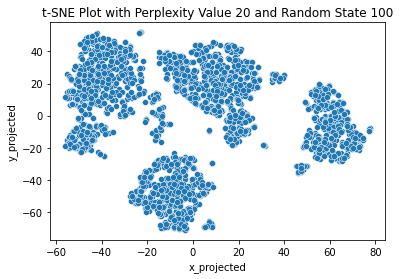

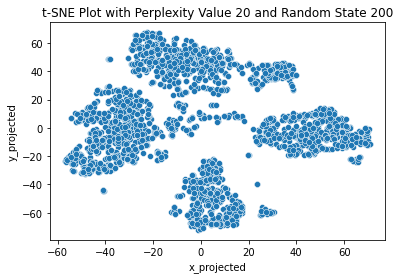

--------------------------------------------


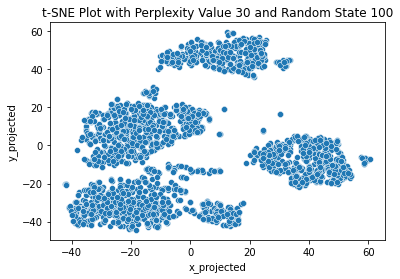

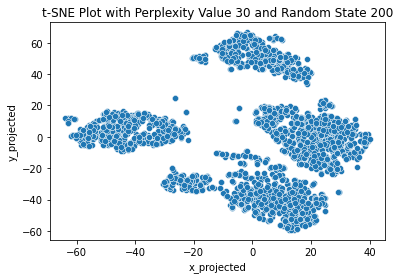

--------------------------------------------


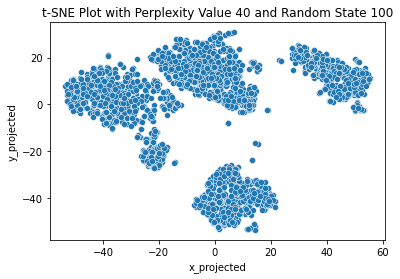

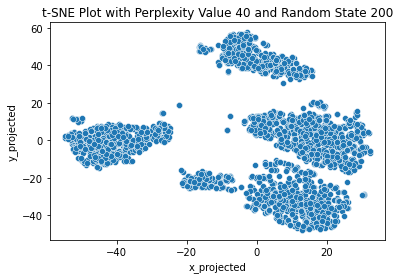

--------------------------------------------


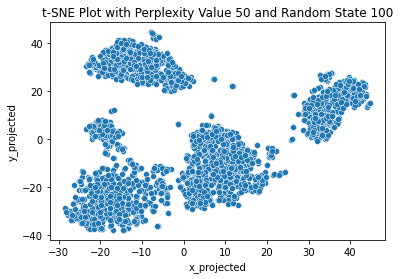

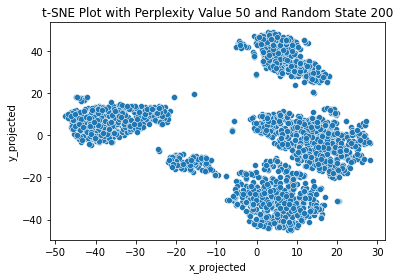

--------------------------------------------


In [35]:
for perp in [5,10,20,30,40,50]:
    for rs in [100,200]:
        tsne = TSNE(n_components=2, perplexity=perp, random_state=rs, metric='precomputed')
        data_tsne = tsne.fit_transform(final_dist_mat)
        df_tsne = pd.DataFrame(data_tsne, columns=['x_projected', 'y_projected'])
        df_combo = pd.concat([df, df_tsne], axis=1)
        sns.scatterplot(x='x_projected',y='y_projected', data=df_combo)
        plt.title('t-SNE Plot with Perplexity Value %s and Random State %s' %(perp, rs))
        #plt.legend(bbox_to_anchor=(1,1))
        plt.show()
    print('--------------------------------------------')

Based on the t-SNE plots, the dataset seems to be clusterable

- From the above t-SNE plots, the perplexity values of 20, 30, 40, and 50 indicate that there are around 4 distinct 'main clusters' in the dataset.

- The clusters don't have any underlying sub-clustering structure.

- These clusters appear to be convex in shape, with some appearing somewhat spherical.

- The clusters are somewhat similar in size, although one cluster appears to be slightly smaller.

- Based on the t-SNE plots, there is very little overlap. All except two clusters in the above t-SNE plot appear to be well- separated to each other.


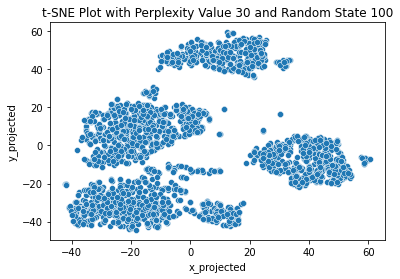

In [36]:
tsne = TSNE(n_components=2, perplexity=30, random_state=100, metric='precomputed')
data_tsne = tsne.fit_transform(final_dist_mat)
df_tsne = pd.DataFrame(data_tsne, columns=['x_projected', 'y_projected'])
df_combo = pd.concat([df, df_tsne], axis=1)
sns.scatterplot(x='x_projected',y='y_projected', data=df_combo)
plt.title('t-SNE Plot with Perplexity Value %s and Random State %s' %(30, 100))
plt.show()

We choose Perplexity value 30 and Random State 100 for our TSNE plot, since we think it is a good representation of our data.

We now look at how each attribute is associated with our clustering structure.

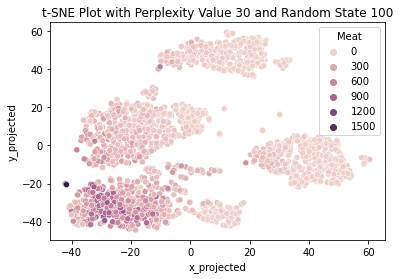

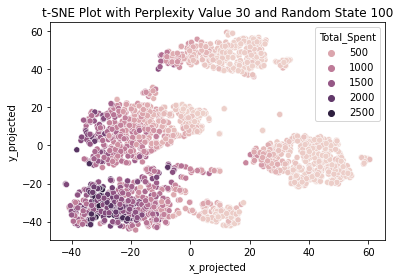

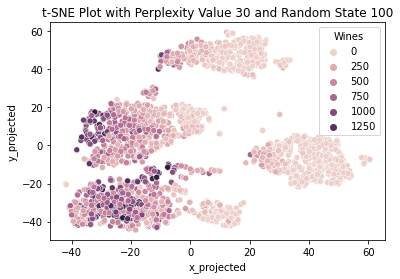

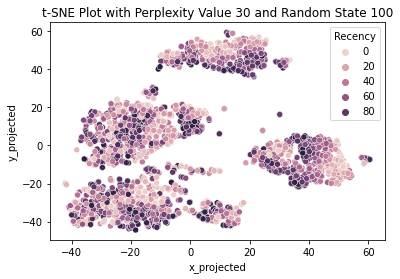

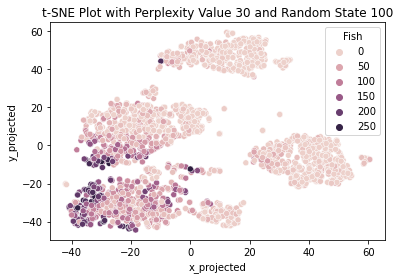

...

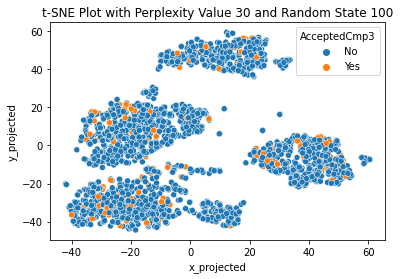

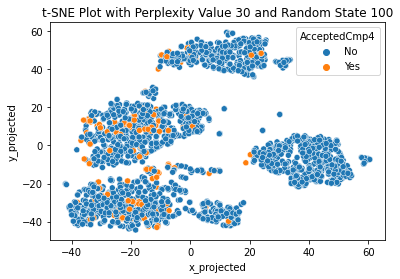

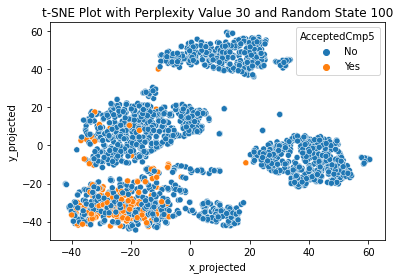

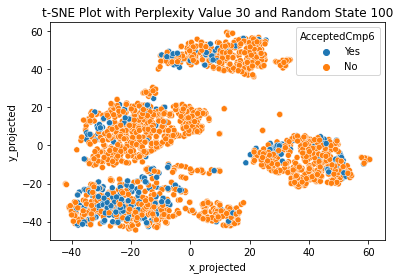

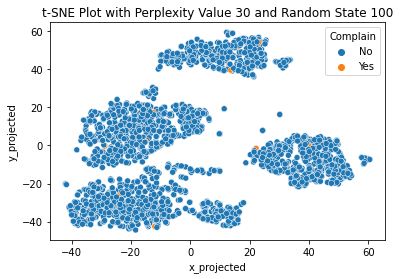

In [37]:
for col in X.columns:
    sns.scatterplot(x='x_projected',y='y_projected',hue=col, data=df_combo)
    plt.title('t-SNE Plot with Perplexity Value %s and Random State %s' %(30, 100))
    plt.show()

From the above plots, we see that:
- Attributes like `Children`, `Teenhome`, and `Kidhome` associate strongly with some clusters, which could mean that this could be an important variable which drives clusterability.
- Attributes like `Education` and `Marital_Status` don't seem to have any association with the clustering structure.
- Attributes like `Total_Spent`, `Total_Purchases`, and `Income` seem to have some association since higher values are clustered together.
- Attributes like `NumWebVistisMonth` and `NumDealsPurchase` seem to show weak clustering association.

## 6. Algorithm Selection Motivation

The Algorithmic Selection process considered both the types of features in the dataset and the business use case. Our goal is to gain insight into the probability of a customer belonging to all the clusters, making soft clustering the preferred approach.

With the above conditions, It seemed ideal to apply the following two algorithms:

- **K-Prototype Clustering**: 
    1. We have mixed data (a mixture of categorical and numerical variables). K-prototypes is specifically designed to handle mixed data types, and performs well when there is a mix of categorical and numerical variables in the dataset.
    2. We also have well-defined clusters. K-prototypes is designed to identify well-defined clusters in the data.
    3. K-prototypes performs best when the number of observations in each cluster is roughly equal. Since in our case the size of each clusters is same, it is an ideal choice.
    4. The cluster shapes are somewhat spherical, so K-prototype would perform well.

- **Fuzzy c-Means Clustering**: 
    1. As the output of this algorithm is a fuzzy clustering membership score, it gives you more information about the certainity of the customer belonging to different clusters.
    2. The algorithm also helps in identifying straddle nodes to reflect the uncertain nature of some customer's cluster assignments.
    3. Since some clusters are more distinct and identifiable than other clusters, Fuzzy c-means is a good alternative.
    4. The clusters are somewhat equal in sizes, so it would perform well.
    5. We want some fuzzy clustering to accomodate for the fact that some customers may belong to more than one cluster. This would not be possible with a hard clustering algorithm.

## 7. Clustering the dataset and Post-Cluster Analysis for K-Prototypes Algorithm

### 7.1 Parameter Selection

For selecting the optimal number of clusters, we use an elbow plot and also look at their corresponding TSNE plots.

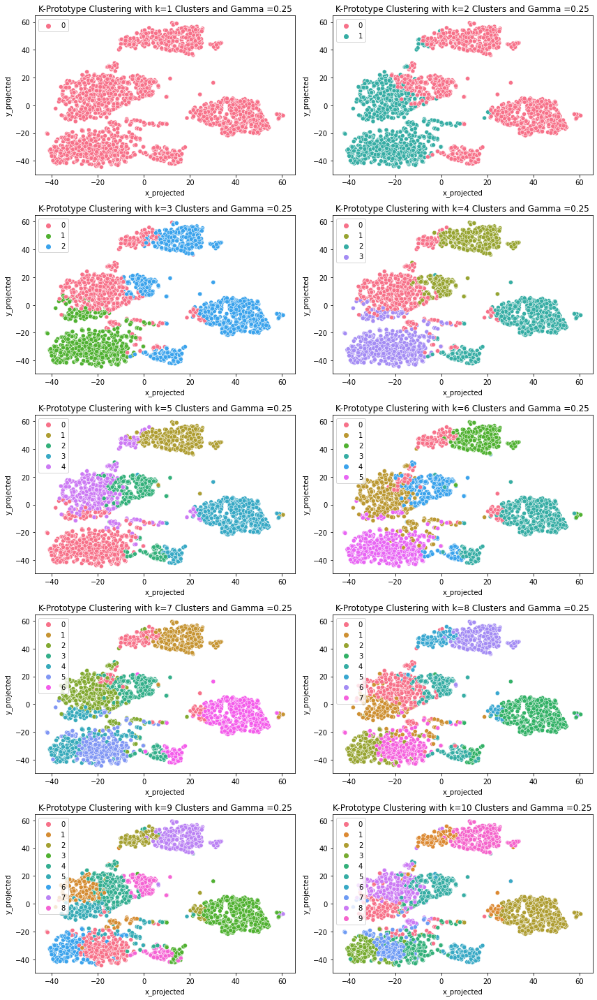

In [38]:
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(12, 20))
gamma = 0.25
cost = []

for k in range(1, 11):
    #Clustering with k-prototypes
    kp = KPrototypes(n_clusters=k, random_state=100, gamma=0.25)
    df_combo['predicted_cluster'] = kp.fit_predict(X, categorical=[20, 21, 22, 23, 24, 25, 26, 27, 28])
    cost.append(kp.cost_)
    
    #Map the resulting cluster labels onto our chosen t-SNE plot
    i = k - 1
    sns.scatterplot(x='x_projected', y='y_projected', hue='predicted_cluster', 
                    palette=sns.color_palette("husl", k), data=df_combo,
                    ax=axes[i // 2, i % 2])
    axes[i // 2, i % 2].set_title('K-Prototype Clustering with k=%s Clusters and Gamma =%s' % (k, gamma))
    axes[i // 2, i % 2].legend(loc='upper left')
    
fig.tight_layout()

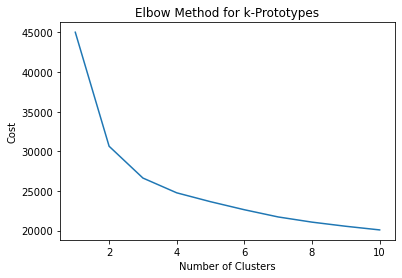

In [39]:
plt.plot(list(range(1, 11)), cost)
plt.xlabel('Number of Clusters')
plt.ylabel('Cost')
plt.title('Elbow Method for k-Prototypes')
plt.show()

Based on the Elbow plot, we see a dramatic elbow at k=2. So, we choose k=2 clusters as our parameter. 

### 7.2 K-Prototype Algorithm

In [40]:
k = 2
kp = KPrototypes(n_clusters = k, gamma = 0.25, random_state = 200)
fit_clusters = kp.fit_predict(X, categorical=[20, 21, 22, 23, 24, 25, 26, 27, 28])
df_combo['predicted_cluster'] = fit_clusters

### 7.3 K-Prototype Algorithm Results

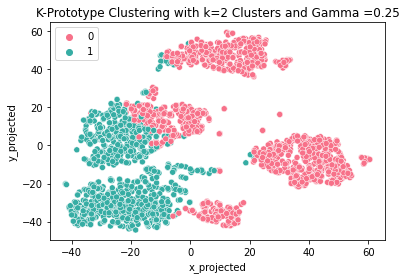

In [41]:
sns.scatterplot(x='x_projected', y='y_projected', hue='predicted_cluster',
                palette=sns.color_palette("husl", k), data=df_combo)
plt.title('K-Prototype Clustering with k=%s Clusters and Gamma =%s' % (k, gamma))
plt.legend(loc='upper left')
plt.show()

We see that the clustering given by k-prototype is not entirely interpretable using just TSNE so we use other methods to find the underlying characteristics. We can look at the centroids of the clusters to gain an insight.

In [42]:
df_centroids_scaled = pd.DataFrame(kp.cluster_centroids_, columns = X.columns)

In [43]:
df_num_centroids_scaled = df_centroids_scaled.drop(columns = cat_cols)
df_cat_centroids = df_centroids_scaled[cat_cols]

In [44]:
df_num_centroids_unscaled = pd.DataFrame(scaler.inverse_transform(df_num_centroids_scaled), columns = df_num_centroids_scaled.columns)
df_centroids_unscaled = pd.concat([df_num_centroids_unscaled, df_cat_centroids], axis = 1)

In [45]:
df_centroids_unscaled

,Meat,Total_Spent,Wines,Recency,Fish,Gold,Sweet,NumWebVisitsMonth,Total_Purchases,NumWebPurchases,...,NumStorePurchases,Education,Marital_Status,AcceptedCmp1,AcceptedCmp2,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp6,Complain
0,35.621329,172.580371,93.023957,48.775889,9.217929,21.984544,6.292117,6.410355,10.042504,2.858578,...,3.833849,Graduation,Married,No,No,No,No,No,No,No
1,351.738328,1218.130293,603.366992,49.373507,77.599349,74.882736,56.192182,3.785016,21.682953,5.809989,...,8.567861,Graduation,Married,No,No,No,No,No,No,No


We see that Cluster 1 has higher purchases and spending in nearly all categories. The categorical columns are not accuractely represented by mode statistic since we have an imbalanced data, so we proceed with other visualisations alter in the sections.

### 7.4 Assessing Clustering Result Separation and Cohesion

To assess our clustering structure, we use average silhoutte score.

In [46]:
k_proto_silhouette_avg = silhouette_score(df_label_enc, df_combo['predicted_cluster'])
print("The average silhouette_score is :", k_proto_silhouette_avg)

The average silhouette_score is : 0.29119525446992955


We don't get a very good score but since we know that the predicted clusters are not that well-separated, it is expected to have a slightly lower score. We also want to look at each individual cluster's cohesion and separation.

In [47]:
def create_silhouette_plot(X, cluster_labels):
    #------------------------------------------------------
    #INPUT:
    #-----------------------------------------------------
    #X=dataframe of objects you clusterted
    #cluster_labels=cluster labels of each of the objects in the dataset X that you just clustered 

    #Gets the unique labels in the cluster_labels
    clabels=np.unique(cluster_labels)
    #Gets the number of unique labels
    k=len(clabels)
    
    #-------------------------------------------------------
    #SETTING UP THE PLOT SPACE
    # Create a subplot with 1 row and 1 columns
    fig, ax1 = plt.subplots(1, 1)
    fig.set_size_inches(18, 7)
    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (k+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (k + 1) * 10])

    #FINDS THE SILHOUETTE SCORE FOR EACH OBJECT
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10

    
    for i in clabels:
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / k)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    plt.show()

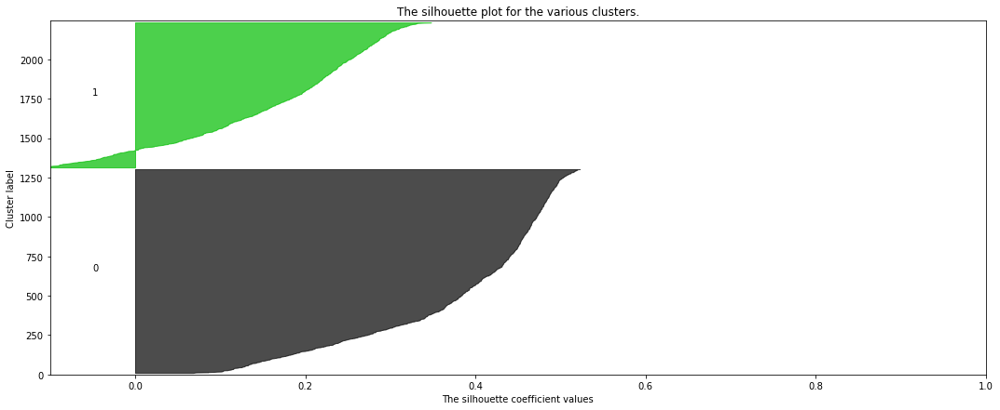

In [48]:
create_silhouette_plot(df_label_enc, df_combo['predicted_cluster'])

From the Silhouette Plot, we see that Cluster 0 has a larger size and is more cohesive, while Cluster 1 has a few negative points, which could indicate that they might fit with other cluster as well. This also leads to a stronger reason for using Fuzzy c-means on this dataset.

### 7.5 Additional Analysis

In [49]:
df_label_enc['predicted_cluster'] = fit_clusters
df_sort = df_label_enc.sort_values(by=['predicted_cluster'])

In [50]:
df_sort = df_sort.drop(cat_cols, axis=1)
df_sort = df_sort.drop(['predicted_cluster'], axis=1)

In [51]:
dist_mat = squareform(pdist(df_sort))

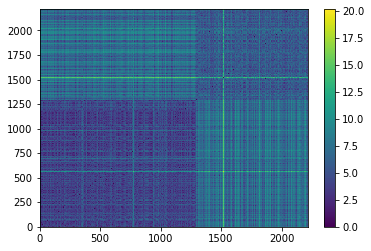

In [52]:
plt.pcolormesh(dist_mat)
plt.colorbar()
N = len(df_sort)
plt.xlim([0,N])
plt.ylim([0,N])
plt.show()

Cluster 1 shows higher cohesion than Cluster 0. The separation looks decent but the presence of high distance points (yellow lines) suggest they might be not a good fit in these clusters or could be outliers.

In [53]:
min_dist=np.min(dist_mat)
max_dist=np.max(dist_mat)

sim_mat=1-(dist_mat-min_dist)/(max_dist-min_dist)

In [54]:
#Count the number of objects in each cluster, and sort by cluster label.
cluster_sizes=df_combo['predicted_cluster'].value_counts().sort_index()
print('Cluster Sizes')
print(cluster_sizes)
print()

#Create a list of square matrices with all ones, each matrix is the size of a cluster.
block_list=[]
for i in cluster_sizes:
    print('Cluster Size:',i)
    block=np.ones((i,i)).tolist()
    block_list.append(block)

#Put these square matrices on the block diagonal of an otherwise 0-matrix
print()
# ideal_sim_mat=block_diag(block_list[0], block_list[1], block_list[2], block_list[3])
ideal_sim_mat=block_diag(block_list[0], block_list[1])

Cluster Sizes
0    1294
1     921
Name: predicted_cluster, dtype: int64

Cluster Size: 1294
Cluster Size: 921



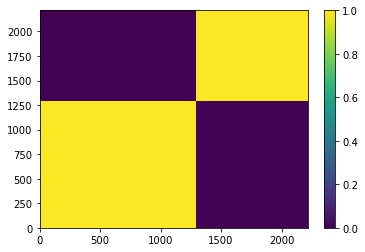

In [55]:
plt.pcolormesh(ideal_sim_mat)
plt.colorbar()
plt.xlim([0,N])
plt.ylim([0,N])
plt.show()

In [56]:
flat_sim_mat=sim_mat.flatten()
flat_ideal_sim_mat=ideal_sim_mat.flatten()

In [57]:
np.corrcoef(flat_sim_mat,flat_ideal_sim_mat)

array([[1.       , 0.5973592],
       [0.5973592, 1.       ]])

We get a correlation coefficient approximately 0.6, which isn't very bad.

In [58]:
kproto_calinski = calinski_harabasz_score(df_scaled, df_combo['predicted_cluster'])
kproto_calinski

1063.8673769341003

This score will be compared against the Fuzzy c-means score to make any performance comment.

### 7.6 Describing the clusters

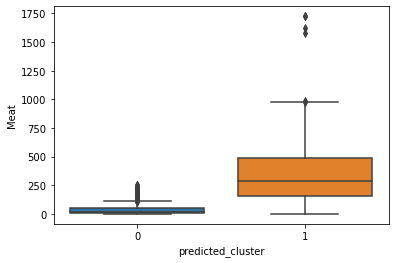

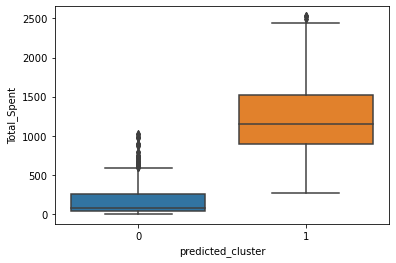

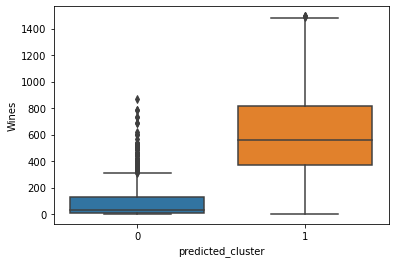

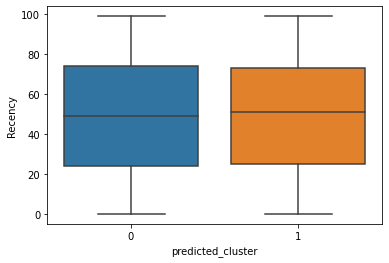

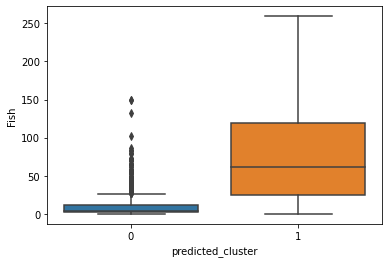

...

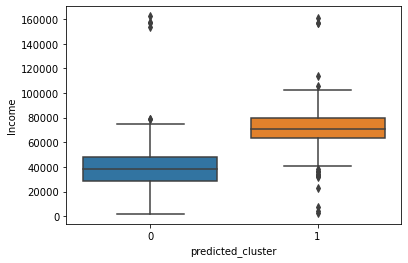

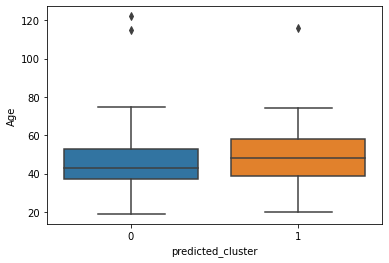

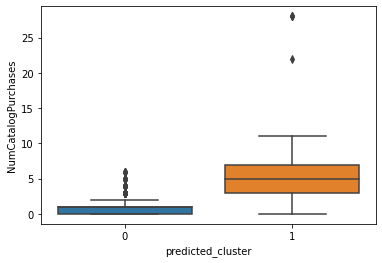

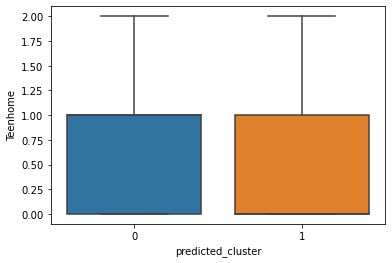

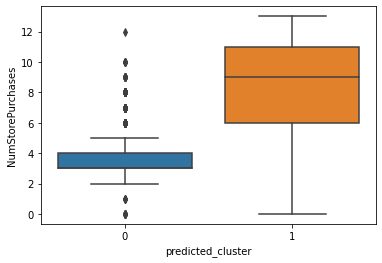

In [59]:
for col in num_cols:
    sns.boxplot(x = df_combo['predicted_cluster'], y=col, data=df_combo)
    plt.show()

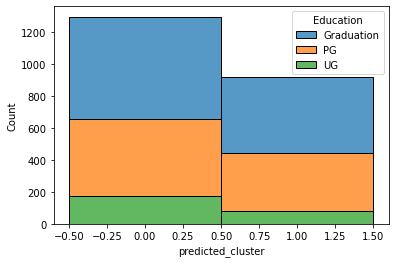

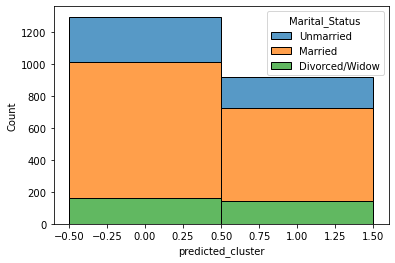

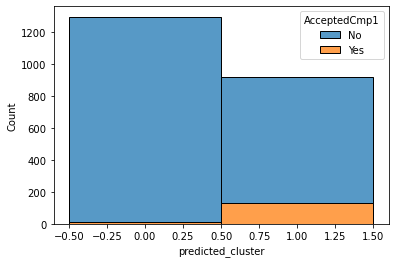

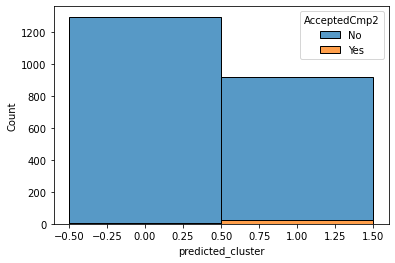

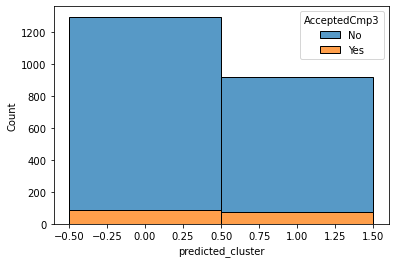

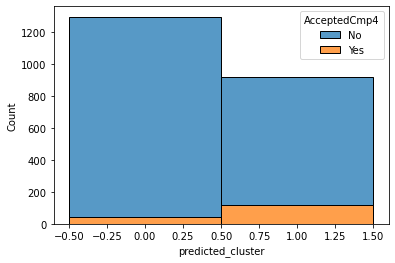

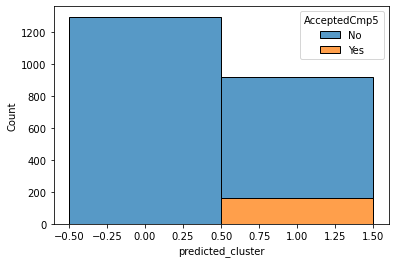

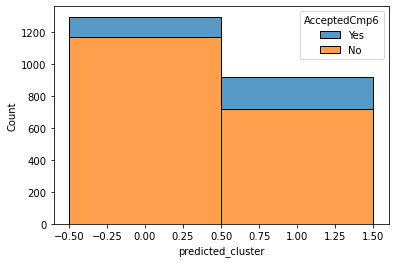

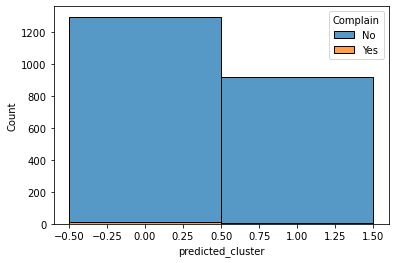

In [60]:
for col in cat_cols:
    sns.histplot(x = df_combo['predicted_cluster'], hue = col, data = df_combo, discrete = True, multiple = "stack")
    plt.show()

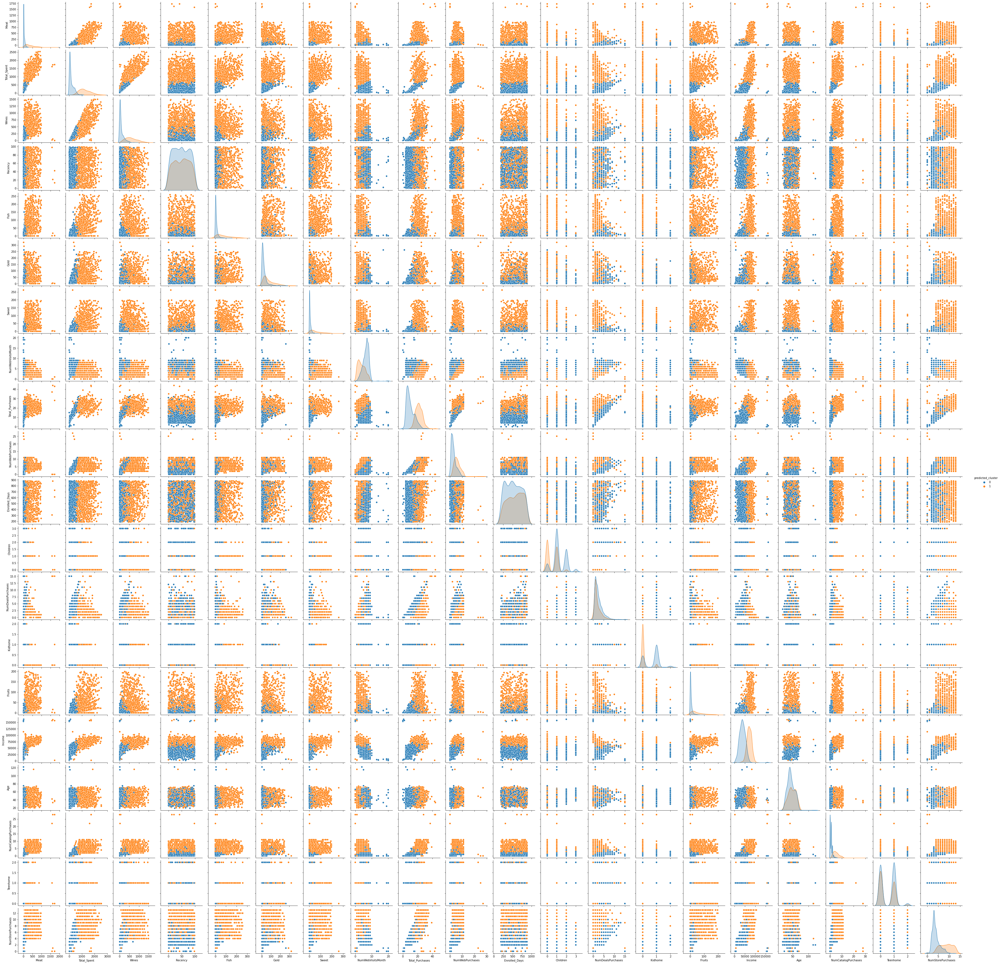

In [61]:
sns.pairplot(df_combo[list(num_cols) + ['predicted_cluster']], 
             hue = 'predicted_cluster')
plt.show()

Based on the above plots, we gain the following valuable insights:

**Cluster 0**

- **Spending**: Customers spend less in all categories by a significant margin.
- **Income**: Customers have lower income than the other cluster. This could explain the lower spending. 
- **Children**: Customer have more children than the other cluster. They have more small kids.
- **Purchases**: Customers don't prefer Catalog and Store Purchases. They have higher number of Web Visits in a month and the number of Deals Purchases is also higher.
- **Campaign Response**: Customers were generally less responsive to Campaigns.

**Cluster 1**

- **Spending**: Customers spend more in all categories by a significant margin.
- **Income**: Customers have higher income than the other cluster. This could explain the higher spending. 
- **Children**: Customer have lesser children than the other cluster. They have no small kids.
- **Purchases**: Customers prefer Catalog and Store Purchases much more. The number of Web Visits in a month is also lesser than the other cluster. The number of Deals Purchases is also lower.
- **Campaign Response**: Customers were generally more responsive to Campaigns.


## 8. Clustering the dataset and Post-Cluster Analysis for Fuzzy C-Means Algorithm

For fuzzy c-means, we perform one-hot encoding of categorical columns.

In [62]:
df_fuzzy_cat = pd.get_dummies(df[cat_cols])
df_fuzzy = pd.concat([df_scaled, df_fuzzy_cat], axis = 1)

### 8.1 Parameter Selection:

We have two parameters to select in this algorithm.  
- Number of clusters, $c$ : This will be selected by plotting the weighted inertias against the number of clusters and choosing the number which gives us greates dip in inertia.
- Weight Parameter, $p$ : This will be selected using the overall fuzziness in the clustering. We will ignore values that give us hard clustering and choose values that give us moderate fuzziness to analyse further those points that have moderate weights in either cluster.

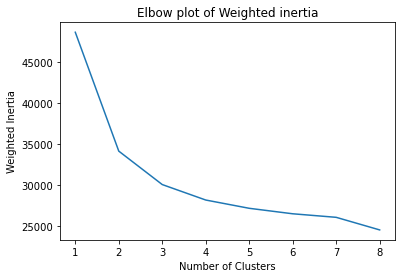

In [63]:
inertia = []
for k in range(1, 9):
    centroids, W, W_0, dist_mat, history, iters, ndpc = cmeans(df_fuzzy.T, c=k, m=1.01, error=1e-6, maxiter=20000, seed=100)
    inertia.append(history[len(history)-1])

plt.plot(range(1, 9), inertia)
plt.title('Elbow plot of Weighted inertia')
plt.xlabel('Number of Clusters')
plt.ylabel('Weighted Inertia')
plt.show()

We see a dramatic elbow at 2 clusters. We will investigate more below.

In [64]:
def visualize_fuzziness(c, p):
    print('Analysis for c=%s and p=%s'%(c,p))

    #Cluster the data using these parameters
    centroids, W, _, _, obj_history, _, ndpc = cmeans(df_fuzzy.T, c=c, m=p, error=1e-6, maxiter=20000, seed=100)

    #Normalized Dunning Partitional Coefficient
    print('Normalized Dunning Partitional Coefficient: ', ndpc)
    print('Final Objective Function Value: ' , obj_history[len(obj_history)-1])

    #Color code t-SNE Plots
    fig, ax = plt.subplots(1, c, figsize=(20, 10))
    plt.suptitle('Fuzzy Clustering: %s clusters and p=%s'%(c,p), fontsize=14)
    for i in range(0, c):

        #Create a column with cluster i membership scores
        df_combo['Cluster %s Membership Score'%str(i)]=W[i,:]

        #Plot the points, color coded by the membership score.
        points = plt.scatter(df_combo["x_projected"], df_combo["y_projected"],
                    c=df_combo['Cluster %s Membership Score'%str(i)],
                            s=30, cmap="BuGn",
                            vmin=0,
                            vmax=1)
        ax[i].scatter(df_combo["x_projected"], df_combo["y_projected"],
                    c=df_combo['Cluster %s Membership Score'%str(i)],
                                                s=30, cmap="BuGn",
                                              vmin=0,
                                              vmax=1)

        fig.colorbar(points, ax=ax[i])
        ax[i].set_title('Cluster %s Membership Scores'%(str(i)))
    plt.show()



Analysis for c=2 and p=1.01
Normalized Dunning Partitional Coefficient:  0.9961235569799
Final Objective Function Value:  34118.8890547038


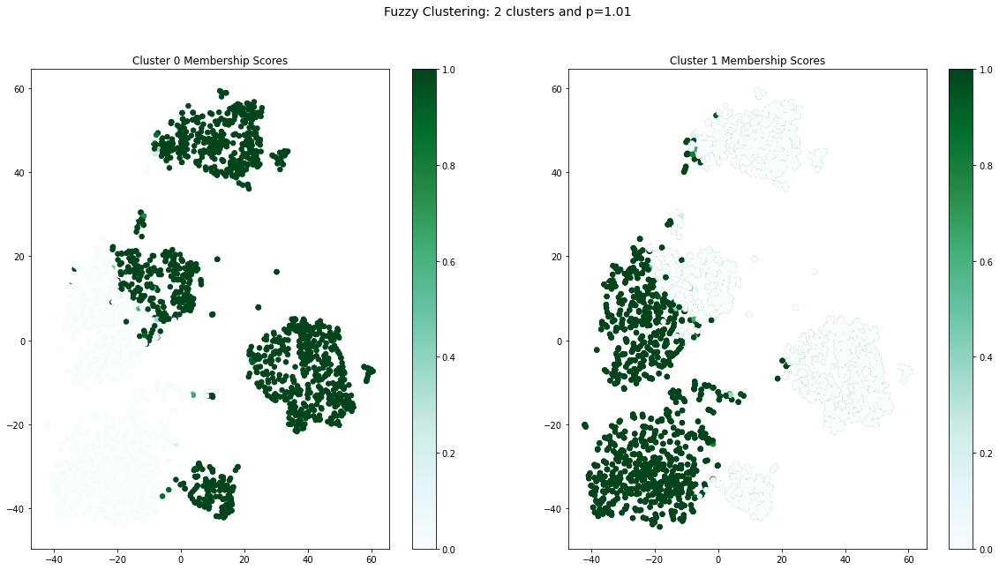

In [65]:
c=2
p=1.01
visualize_fuzziness(c, p)

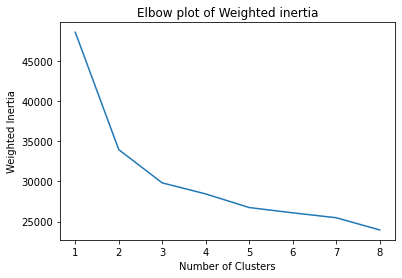

In [66]:
p = 1.1
inertia = []
for k in range(1, 9):
    centroids, W, W_0, dist_mat, history, iters, ndpc = cmeans(df_fuzzy.T, c=k, m=1.1, error=1e-6, maxiter=20000, seed=100)
    inertia.append(history[len(history)-1])

plt.plot(range(1, 9), inertia)
plt.title('Elbow plot of Weighted inertia')
plt.xlabel('Number of Clusters')
plt.ylabel('Weighted Inertia')
plt.show()

Analysis for c=2 and p=1.1
Normalized Dunning Partitional Coefficient:  0.966198385578904
Final Objective Function Value:  33959.7381057436


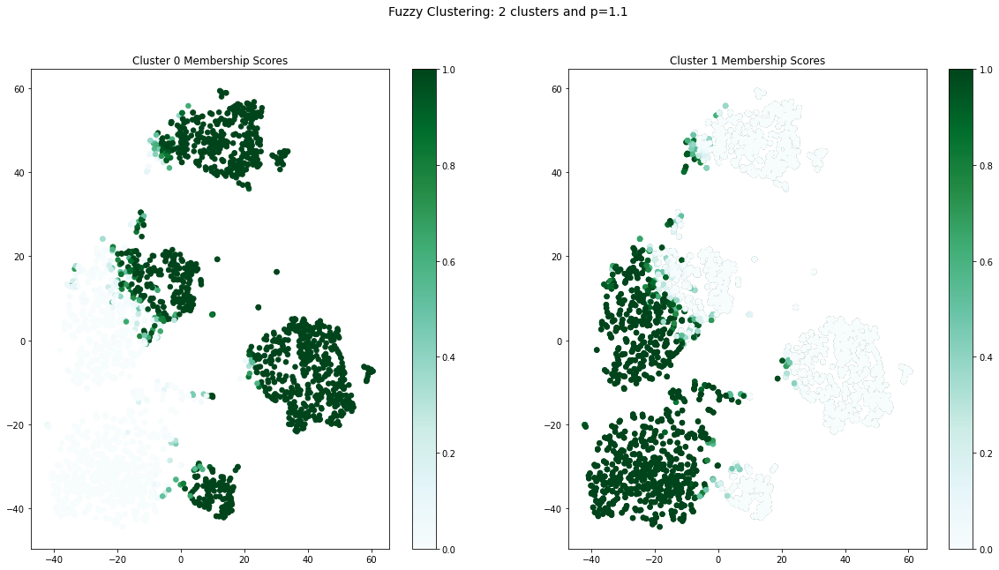

Analysis for c=2 and p=1.2
Normalized Dunning Partitional Coefficient:  0.9302525588490581
Final Objective Function Value:  33521.483027306516


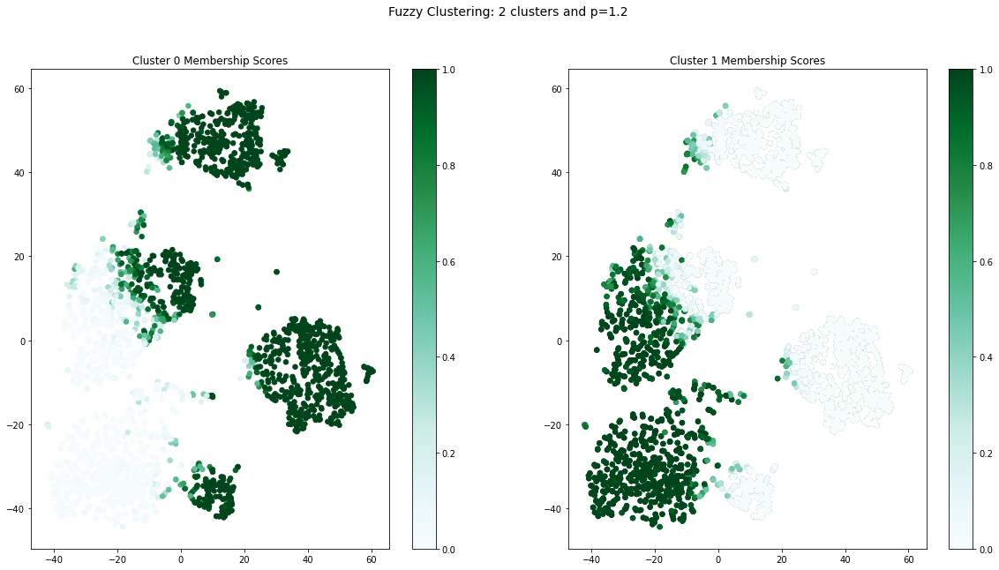

Analysis for c=2 and p=1.3
Normalized Dunning Partitional Coefficient:  0.8837821638042678
Final Objective Function Value:  32796.36540794635


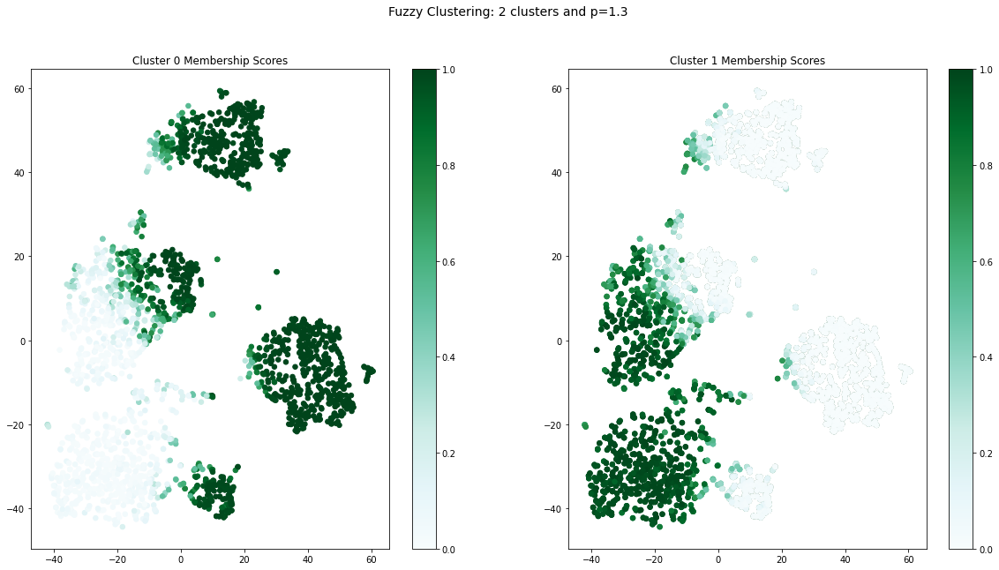

Analysis for c=2 and p=1.4
Normalized Dunning Partitional Coefficient:  0.8315927652852062
Final Objective Function Value:  31804.856420013268


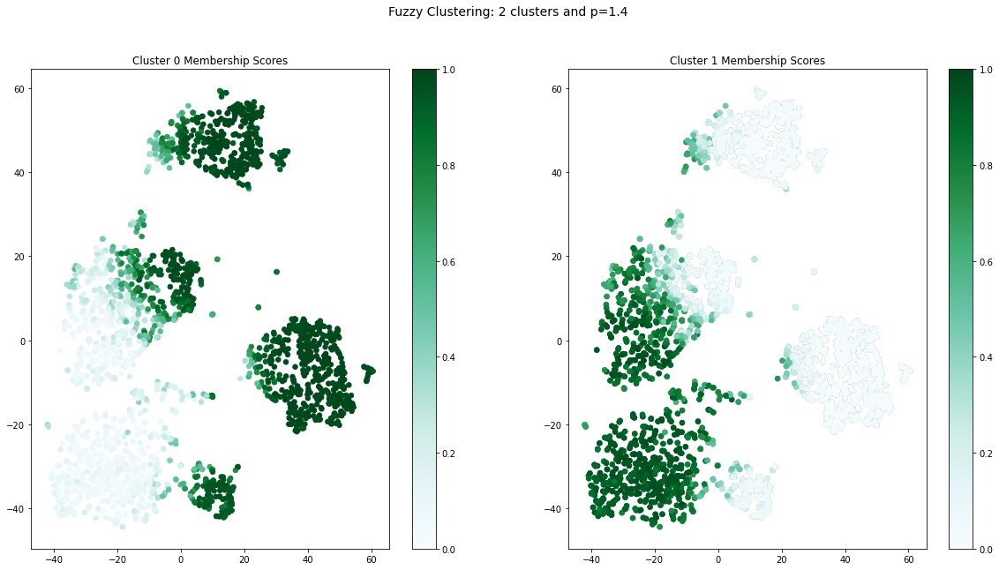

In [67]:
c=2
for p in [1.1, 1.2, 1.3, 1.4]:
    visualize_fuzziness(c, p)

Before increasing p further, we should have a look at the elbow plot for a clustering structure.

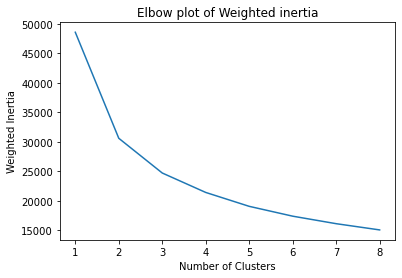

In [68]:
p = 1.5
inertia = []
for k in range(1, 9):
    centroids, W, W_0, dist_mat, history, iters, ndpc = cmeans(df_fuzzy.T, c=k, m=p, error=1e-6, maxiter=20000, seed=100)
    inertia.append(history[len(history)-1])

plt.plot(range(1, 9), inertia)
plt.title('Elbow plot of Weighted inertia')
plt.xlabel('Number of Clusters')
plt.ylabel('Weighted Inertia')
plt.show()

There is still a huge drop at k = 2. We may take c = 2 and p = 1.5 to have a fuzzy clustering.

Analysis for c=2 and p=1.5
Normalized Dunning Partitional Coefficient:  0.7796318495851365
Final Objective Function Value:  30605.299986463528


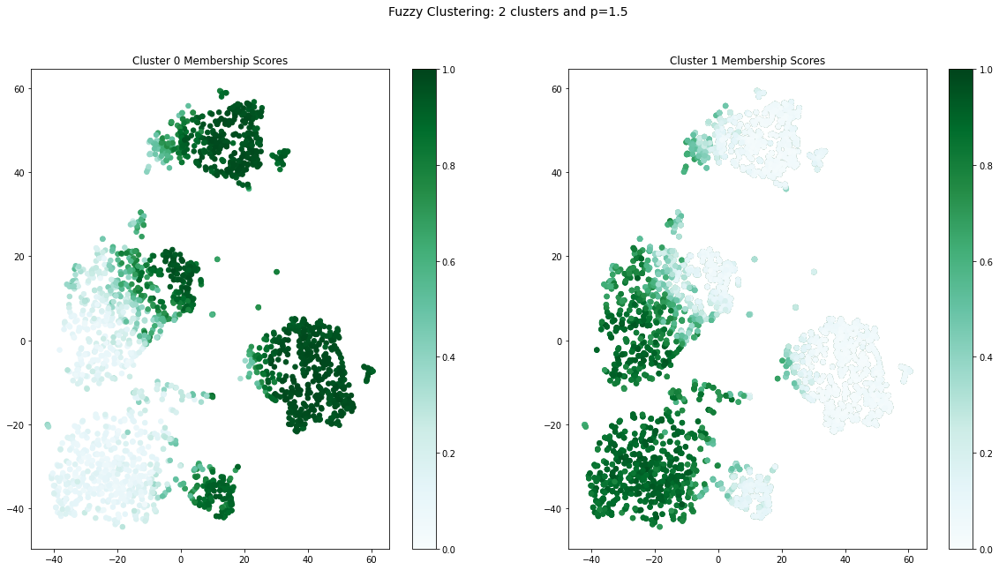

In [69]:
c=2
p=1.5
visualize_fuzziness(c, p)

We can see a lot of points having smaller weights and belonging to the two clusters in nearly equal measures. Our goal will be to analyse the characteristics of these points. Let's run the algorithm with p = 1.5 and c = 2.

### 8.2 Fuzzy C-means Algorithm

In [70]:
# Clustering the dataset using Fuzzy c-means:
centroids, W, W_0, dist_mat, history, iters, ndpc = cmeans(df_fuzzy.T, c=2, m=1.5, error=1e-6, maxiter=20000, seed=100)

### 8.3 Fuzzy C-means Results

Let's analyse the membership scores in the fuzzy clustering.

Highest Cluster Membership Scores (Sorted)


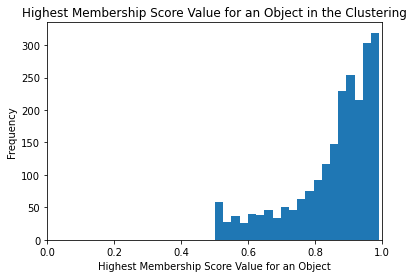

In [71]:
cluster_columns=['Cluster %s Membership Score'%(str(i)) for i in range(0,2)]
df_membership=pd.DataFrame(W.T, columns=cluster_columns)
highest_membership_scores=df_membership.T.max()

print('Highest Cluster Membership Scores (Sorted)')
# print(highest_membership_scores.sort_values())

if highest_membership_scores.max()>highest_membership_scores.min()+.00001:
    plt.hist(highest_membership_scores, bins=20)
    plt.title('Highest Membership Score Value for an Object in the Clustering')
    plt.xlabel('Highest Membership Score Value for an Object')
    plt.ylabel('Frequency')
    plt.xlim([0,1])
    plt.show()

The plot shows none of the points having maximum membership score less than 0.5 since we have just two clusters. We can see a lot of observations that have maximum (greater) membership scores lying in 0.5 to 0.8 zone. These can be having characteristics of either cluster. While k-prototype clustering provide a hard assignment to these points, fuzzy clustering can show the uncertainty of our assignment for these points. 

#### **Hard Partitioning**

But, before we dig deeper into this "fuzzy" behaviour of these observations, let's do the hard partitioning to analyse our clustering through evaluation metrics.

In [72]:
# Creating a column for fuzzy cluster hard assignment
df_combo['Fuzzy Cluster Assignment'] = df_membership.idxmax(axis=1).apply(lambda x: int(x.split(" ")[1]))

In [73]:
df_combo['Fuzzy Cluster Assignment'].value_counts()

0    1276
1     939
Name: Fuzzy Cluster Assignment, dtype: int64

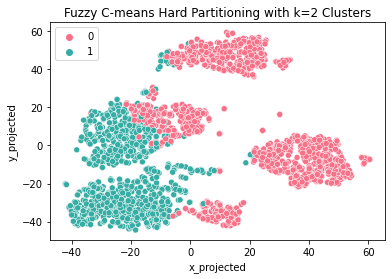

In [74]:
k = 2
sns.scatterplot(x='x_projected', y='y_projected', hue='Fuzzy Cluster Assignment',
                palette=sns.color_palette("husl", k), data=df_combo)
plt.title('Fuzzy C-means Hard Partitioning with k=%s Clusters' % (k))
plt.legend(loc='upper left')
plt.show()

The fuzzy clustering algorithm with hard assignment partitions the data almost similar to the k-prototype algorithm with almost same sizes of the two clusters.

#### **Centroids**

Now, let's analyse the centroids and look for similarity between k-prototype centroids.

In [75]:
centroids = pd.DataFrame(centroids, columns = df_fuzzy.columns)
centroids

,Meat,Total_Spent,Wines,Recency,Fish,Gold,Sweet,NumWebVisitsMonth,Total_Purchases,NumWebPurchases,...,AcceptedCmp3_No,AcceptedCmp3_Yes,AcceptedCmp4_No,AcceptedCmp4_Yes,AcceptedCmp5_No,AcceptedCmp5_Yes,AcceptedCmp6_No,AcceptedCmp6_Yes,Complain_No,Complain_Yes
0,-0.540287,-0.674632,-0.593835,-0.007528,-0.478857,-0.418423,-0.461940,0.414967,-0.633514,-0.466073,...,0.930712,0.069288,0.965873,0.034127,0.991433,0.008567,0.898446,0.101554,0.989308,0.010692
1,0.779007,0.939738,0.806320,0.013555,0.687739,0.553505,0.663603,-0.597770,0.824454,0.581295,...,0.922032,0.077968,0.878974,0.121026,0.832341,0.167659,0.783788,0.216212,0.992554,0.007446


In [76]:
fuzzy_cat_centroids = pd.DataFrame(centroids.iloc[:, 20:], columns=df_fuzzy_cat.columns)
fuzzy_cat_centroids

,Education_Graduation,Education_PG,Education_UG,Marital_Status_Divorced/Widow,Marital_Status_Married,Marital_Status_Unmarried,AcceptedCmp1_No,AcceptedCmp1_Yes,AcceptedCmp2_No,AcceptedCmp2_Yes,AcceptedCmp3_No,AcceptedCmp3_Yes,AcceptedCmp4_No,AcceptedCmp4_Yes,AcceptedCmp5_No,AcceptedCmp5_Yes,AcceptedCmp6_No,AcceptedCmp6_Yes,Complain_No,Complain_Yes
0,0.490009,0.371094,0.138897,0.127801,0.654457,0.217743,0.988337,0.011663,0.995383,0.004617,0.930712,0.069288,0.965873,0.034127,0.991433,0.008567,0.898446,0.101554,0.989308,0.010692
1,0.527492,0.389223,0.083284,0.151852,0.634715,0.213433,0.861087,0.138913,0.975280,0.024720,0.922032,0.077968,0.878974,0.121026,0.832341,0.167659,0.783788,0.216212,0.992554,0.007446


In [77]:
# De-dummifying the variables to extract the original categorical ones:
orig_cat = pd.DataFrame()
for name in X_cat.columns:
    cols = []
    for dummy_cols in fuzzy_cat_centroids.columns:
        if name in dummy_cols:
            cols.append(dummy_cols)
    df_cat_split = fuzzy_cat_centroids[cols]
    orig_cat[name] = df_cat_split.idxmax(axis=1).apply(lambda x: x.split("_")[-1])

orig_cat

,Education,Marital_Status,AcceptedCmp1,AcceptedCmp2,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp6,Complain
0,Graduation,Married,No,No,No,No,No,No,No
1,Graduation,Married,No,No,No,No,No,No,No


In [78]:
# Extracting unscaled centroids:
fuzzy_num_centroids_scaled = pd.DataFrame(centroids.iloc[:, 0:20], columns = df_scaled.columns)
fuzzy_cat_centroids = orig_cat
fuzzy_num_centroids_unscaled = pd.DataFrame(scaler.inverse_transform(fuzzy_num_centroids_scaled), columns = fuzzy_num_centroids_scaled.columns)
fuzzy_centroids_unscaled = pd.concat([fuzzy_num_centroids_unscaled, fuzzy_cat_centroids], axis = 1)
fuzzy_centroids_unscaled

,Meat,Total_Spent,Wines,Recency,Fish,Gold,Sweet,NumWebVisitsMonth,Total_Purchases,NumWebPurchases,...,NumStorePurchases,Education,Marital_Status,AcceptedCmp1,AcceptedCmp2,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp6,Complain
0,45.897845,200.660850,104.942848,48.806502,11.434326,22.300795,8.069543,6.325161,10.023238,2.808339,...,3.877546,Graduation,Married,No,No,No,No,No,No,No
1,341.764092,1173.785525,577.172328,49.416712,75.303661,72.657311,54.293675,3.868955,21.206608,5.679022,...,8.389504,Graduation,Married,No,No,No,No,No,No,No


The unscaled centroids obtained from the fuzzy clustering are almost similar in case of numerical variables and exactly same in case of categorical ones.

### 8.4. Assessing Clustering Result Separation and Cohesion

In [79]:
# Average silhouette score:
fuzzy_silhouette_avg = silhouette_score(df_label_enc, df_combo['Fuzzy Cluster Assignment'])
print("The average silhouette_score is :", fuzzy_silhouette_avg)

The average silhouette_score is : 0.29652052803057594


The average silhouette score is similar to k-prototype's score.

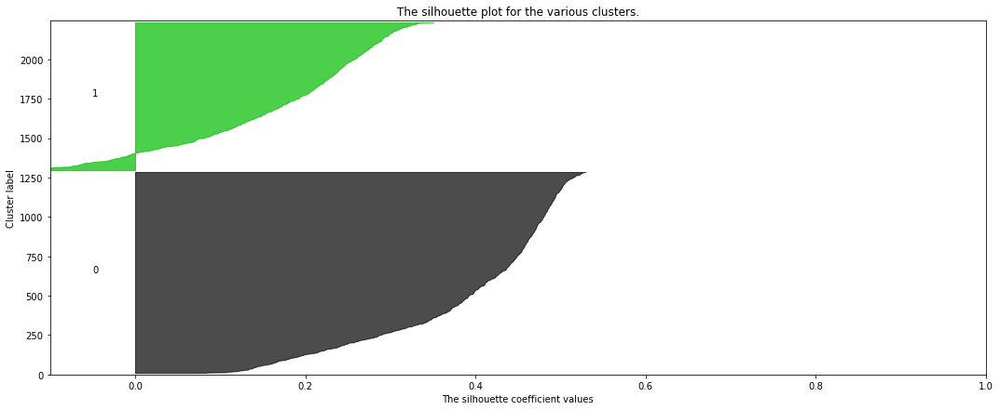

In [80]:
create_silhouette_plot(df_label_enc, df_combo['Fuzzy Cluster Assignment'])

The plot is also almost same. The points in Cluster 0 are much more cohesive and well separated from cluster 1 than those in Cluster 1.

### 8.5 Additional Analysis

In [81]:
# Creating sorted distance matrix on the basis of cluster assignment
df_label_enc['Assigned Fuzzy Clustering'] = df_combo['Fuzzy Cluster Assignment']
df_sort = df_label_enc.sort_values(by=['Assigned Fuzzy Clustering'])
df_sort = df_sort.drop(cat_cols, axis=1)
df_sort = df_sort.drop(['Assigned Fuzzy Clustering'], axis=1)
dist_mat = squareform(pdist(df_sort))

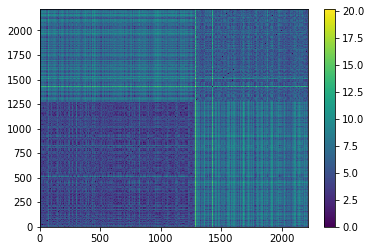

In [82]:
# Creating a cluster sorted distance matrix:
plt.pcolormesh(dist_mat)
plt.colorbar()
N = len(df_sort)
plt.xlim([0,N])
plt.ylim([0,N])
plt.show()

The matrix also shows pretty decent separation of points in the two clusters although cluster 0 is very cohesive with deep blue lines. This is not so much in case of cluster 1 where we find some many light blue lines. Now let's compare this matrix with the ideal cluster sorted matrix.

In [83]:
min_dist=np.min(dist_mat)
max_dist=np.max(dist_mat)

sim_mat=1-(dist_mat-min_dist)/(max_dist-min_dist)
#Count the number of objects in each cluster, and sort by cluster label.
cluster_sizes=df_combo['Fuzzy Cluster Assignment'].value_counts().sort_index()
print('Cluster Sizes')
print(cluster_sizes)
print()

Cluster Sizes
0    1276
1     939
Name: Fuzzy Cluster Assignment, dtype: int64



In [84]:
#Create a list of square matrices with all ones, each matrix is the size of a cluster.
block_list=[]
for i in cluster_sizes:
    print('Cluster Size:',i)
    block=np.ones((i,i)).tolist()
    block_list.append(block)

#Put these square matrices on the block diagonal of an otherwise 0-matrix
print()
# ideal_sim_mat=block_diag(block_list[0], block_list[1], block_list[2], block_list[3])
ideal_sim_mat=block_diag(block_list[0], block_list[1])

Cluster Size: 1276
Cluster Size: 939



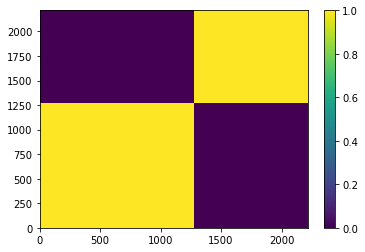

In [85]:
plt.pcolormesh(ideal_sim_mat)
plt.colorbar()
plt.xlim([0,N])
plt.ylim([0,N])
plt.show()

In [86]:
flat_sim_mat=sim_mat.flatten()
flat_ideal_sim_mat=ideal_sim_mat.flatten()

In [87]:
np.corrcoef(flat_sim_mat,flat_ideal_sim_mat)

array([[1.        , 0.60459568],
       [0.60459568, 1.        ]])

As we can see the correlation between the ideal distance matrix and our distance matrix is quite decent (0.6). Let's also test our clustering on the Calinski Harabasz Score.

In [88]:
fuzzy_calinski = calinski_harabasz_score(df_scaled, df_combo['Fuzzy Cluster Assignment'])
fuzzy_calinski

1063.5943026865477

The score is nearly similar to that of K-prototypes. This may suggest that both algorithms perform similarly.

### 8.6 Describing Each Cluster and Moderate weight points

Now, let's analyse the points the points which are not having very high weights for either cluster. For this, we are considering points that have the greater membership score between 0.50 and 0.80.

In [89]:
fuzzy_points = df_membership[df_membership.max(1) < 0.8]
fuzzy_points['Fuzzy Cluster Assignment'] = df_membership.idxmax(axis=1).apply(lambda x: int(x.split(" ")[1]))

In [90]:
fuzzy_points.shape

(562, 3)

We can see there are 562 points that have cluster assignment that we can't be very definitive on the cluster they belong to. Let's analyze the numerical attributes of these points and compare with those in the two main clusters.

In [91]:
df_combo_fuzzy = df_combo.iloc[fuzzy_points.index, :]

First, let's look at the categorical variables in the two clusters.

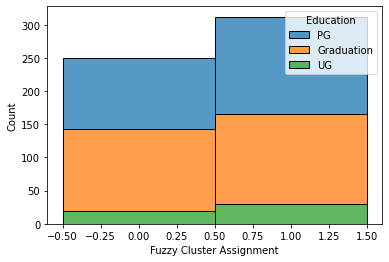

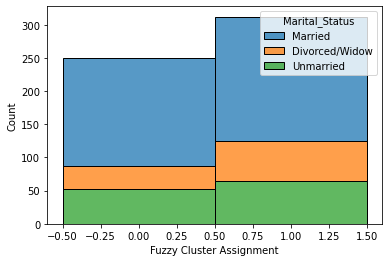

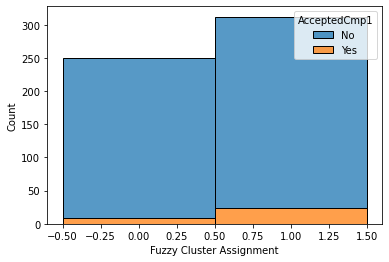

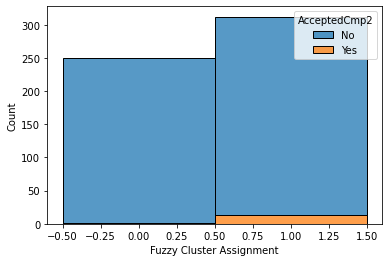

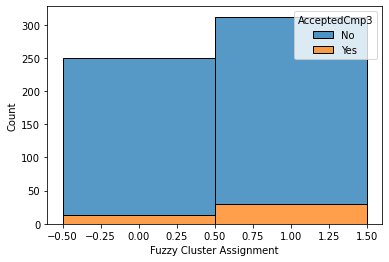

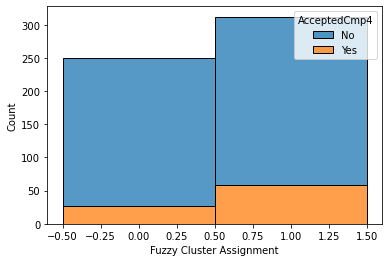

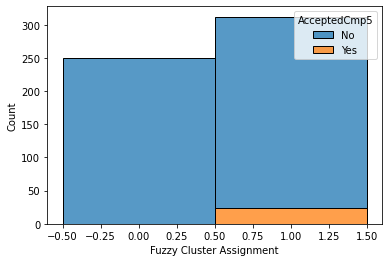

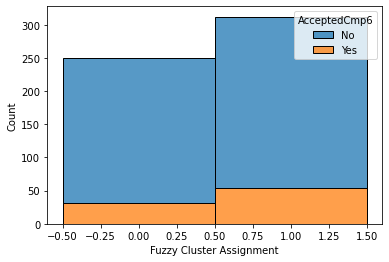

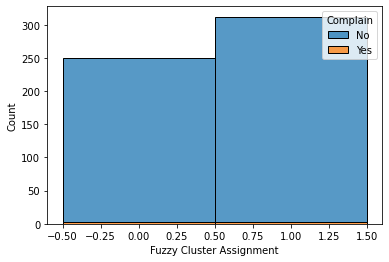

In [92]:
for col in cat_cols:
    sns.histplot(x = df_combo['Fuzzy Cluster Assignment'], hue = col, data = df_combo_fuzzy, discrete = True, multiple = "stack")
    plt.show()

From the plots of the categorical variables, we can observe that:  
- Cluster 1 has more positive response to all the campaigns in comparison to Cluster 0.
- In case of `Education` and `Marital Status` variables, there is no apparent distinction between the two clusters.

Below, we have plotted the box plots of the numerical variables of the two clusters and the histogram of these values for the points that have non-definitive weights in either cluster.

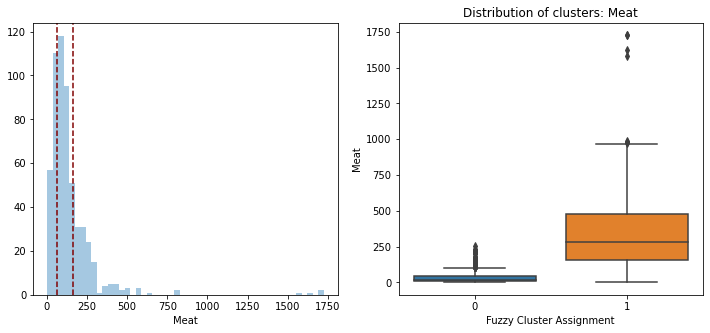

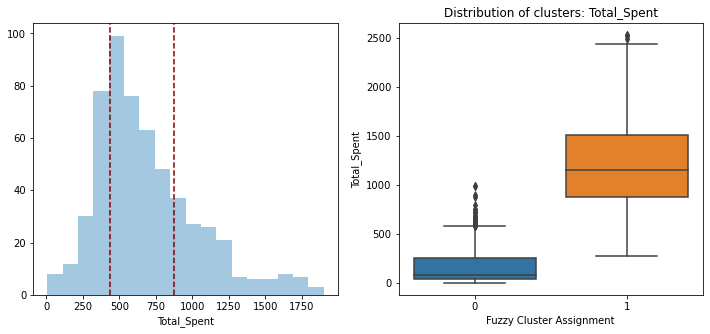

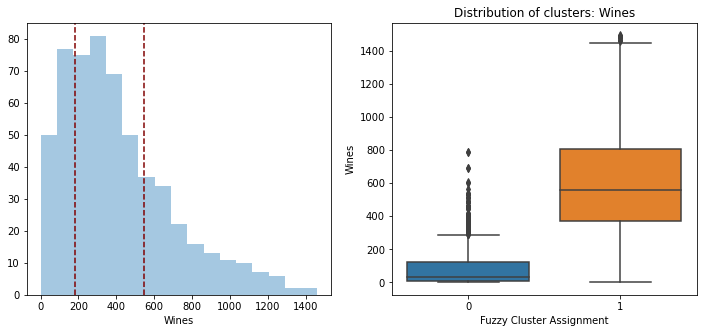

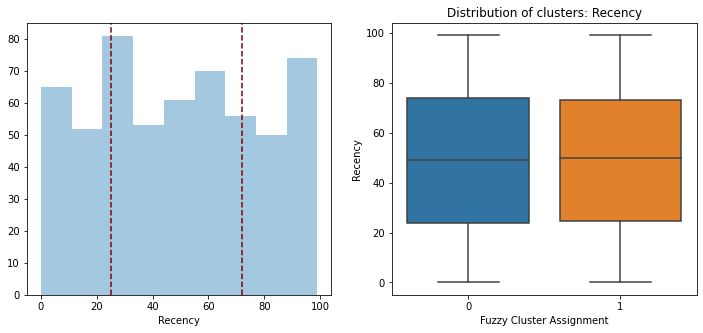

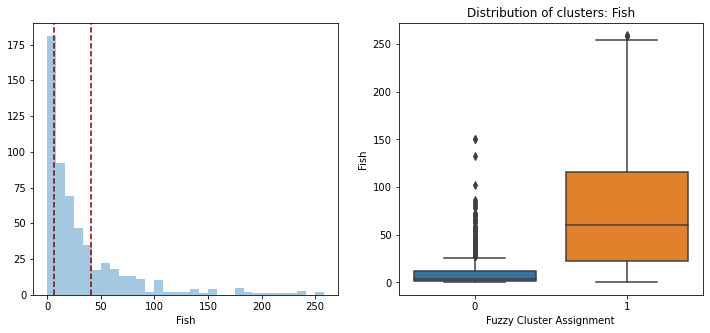

...

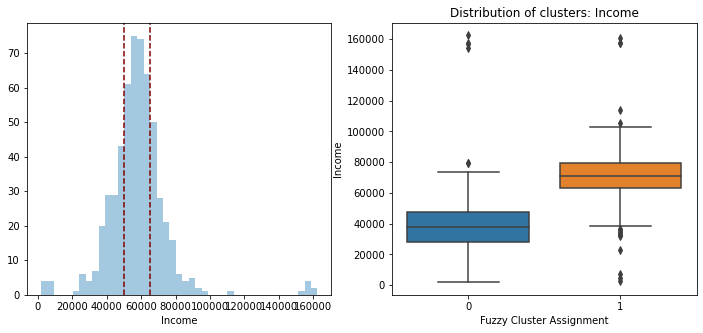

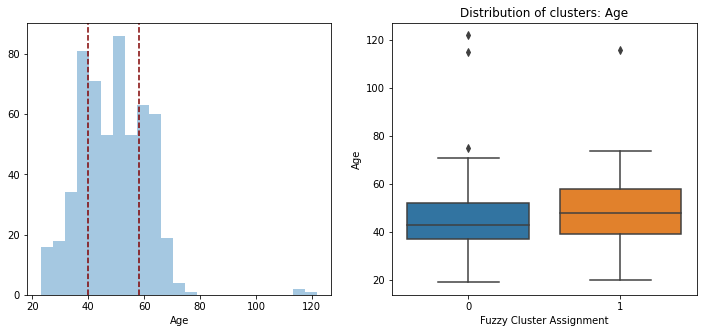

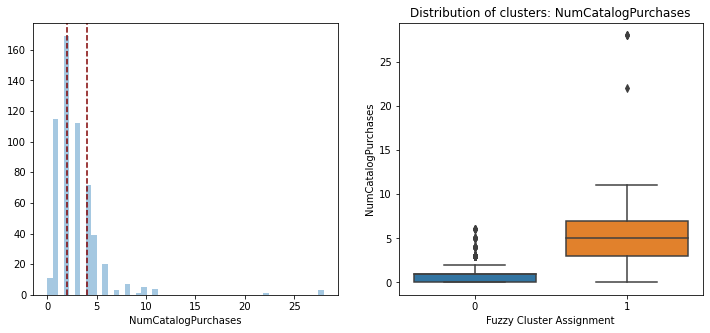

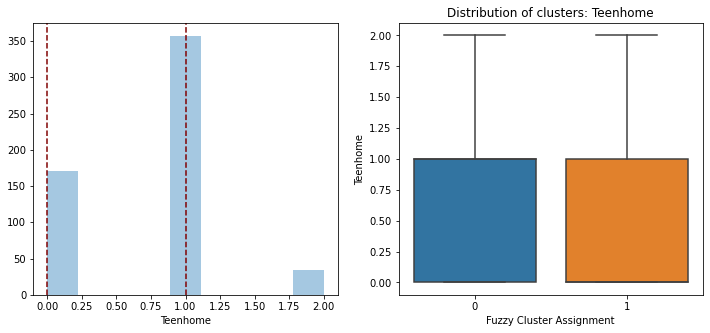

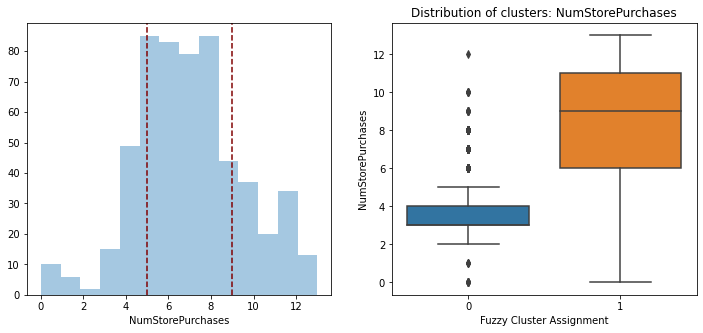

In [93]:
for col in num_cols:
    # Create a scatterplot on the left
    fig, axs = plt.subplots(1, 2, figsize=(12, 5))
    # plt.subplot(2, 1, 1)
    sns.distplot(df_combo_fuzzy[col], kde=False, ax=axs[0])
    plt.title('Fuzzy Points Distribution: %s' %(col))

    # Calculate the interquartile range
    q1 = df_combo_fuzzy[col].quantile(0.25)
    q3 = df_combo_fuzzy[col].quantile(0.75)
    iqr = q3 - q1

    # Add vertical lines for the IQR
    axs[0].axvline(x=q1, color='maroon', linestyle='--')
    axs[0].axvline(x=q3, color='maroon', linestyle='--')

    # print("")
    # print("")
    # # Create a histogram on the right
    # plt.subplot(2, 1, 2)
    sns.boxplot(x = df_combo['Fuzzy Cluster Assignment'], y=col, data=df_combo, ax = axs[1])
    plt.title('Distribution of clusters: %s' %(col))
    # fig.tight_layout()

    # Show the plots
    plt.show()

From the plots, we can conclude:  

- **Children**: The two clusters are quite different in terms of their children's counts, with one of them having customers with 1 or 2 child(ren) while the other having customers with 1 child or less. In case of observations with moderate weights in either cluster, the majority of them had 1 child.  
- **Purchases**: The number of total purchases separates the two clusters quite cleanly. However, for the moderate weight points, we can see the number of total purchases is mostly in the interval (16, 22) whereas the clusters have (5, 13) and (18, 25) approximate intervals. Since cluster 0 customers are less responsive to campaigns are those in 1 are more responsive, we need to have different straegies for the two groups of customers. However, we can consider the interval (16, 22) as the low-hanging fruits in terms of campaign success and can target them first. 
- **Income**: Like the number of purchases, the moderate weight customers fall between the IQR for the two clusters, i.e. approximately USD 50000 to 62000. This income group can be thought in terms of targetting the campaign with greater possibility of success.
- **Spending**: Spending is highly correlated with income. The cluster having higher income also has more spending which is obvious. However, in case of spending we have a narrower zone than the interval between the range of the two clusters where most moderate weight customers fall.
- **Individual Products**: For all individual classes of products like meat, wine, sweets, etc., we see a similar trend. The moderate weight customers always fall in the range between the upper quartile of the cluster 0 and the lower quartile of cluster 1.

To conclude, while we can have the above analysis objectively commenting on the clustering the customers between two groups, we can subjectively also create a third group through fuzzy clustering and post-clustering analysis, with attributes falling in the intermediate range which might not be a organized if we choose three clusters to start with.

## 9. Analysis Summary and Conclusion 

### 9.1. Algorithm Comparison Summary

- **Algorithm Performance:** We tried two algorithms: k-Prototypes and Fuzzy c-means to cluster our data set. The performance of the two clustering algorithms given our research goals are as follows:
  - **K-Prototype:** This algorithm performs decently in clustering the dataset, with the average silhouette scores around 0.3. However, given the fact there is some overlap between the clusters, this score can be considered good. We also analysed the cluster-sorted distance matrix and the coorelation with the ideal matrix came to be about 0.6 which is quite decent.
  - **Fuzzy c-means:** Our objective behind implementing this algorithm was to further analyse the customers that do not fall definitively in any of the cluster. Upon extracting hard partition assignments from this algorithm, we got similar results in terms of clustering performance as in k-prototype. Apart from this, we got to know about the attributes of the "straddle nodes" also.

- **Algorithm Results**
    - The hard partition clustering attained from the two algorithms agreed with each other. The distribution of the attributes in each cluster were the same. Also, the centroids of the two clusters were almost same in case of numerical variables and exactly same in case of categorical ones. However, fuzzy c-means, as expected, was able to recognize some observations that can belong to either cluster which is not possible with a hard clustering algorithm like k-prototype.

### 9.2.  Conclusion and Insights Summary

We got some interesting insights into the spending habits of the customers that can be summarized as under:

- Income or number of children in the family correlated with spending amount.
- While we expected some of the results like purchases of each product correlating with income, we found some differences between the spending on each group of products. 
- There were some unexpected insights like no appreciable correlation between `Marital Status` or `Education` on spending habits which we initially thought there might be. Both the clusters had comparable proportion of each category of customers.
- The assessment of Campaign success was an important insight from the business point of view since one of the clusters showed more success for almost all the campaigns than the other. 
- The cluster with higher purchases and income responded better than the other cluster, which suggests that these are the prime customers who should be targeted more often.
 - This can help the stakeholders to target specific customers to increase their campaign success without incurring large expenses. 
 - The cluster which didn't respond well to campaigns wasa noticed to purchase more products through Deals. Thus, by comparing the strategies in the different campaigns, they can have insights into what strategy, e.g. giving free gift coupons, or having a discount, etc. led to more success in each cluster. 
 - It would also be important to note that the current campaign strategy caused a low response from low Income Cluster.
 - The insights from fuzzy c-means can also help them in having a level-based approach towards targetting customers. The customers that are not being clustered with certainty in either cluster can be targetted with minimal funds and effort.


## 10. Group Contribution Report

This project was the result of valuable contributions from all the members of the group. Starting with the dataset collection till the report writing, the group has been unanimous in the decisions. In the beginning steps, the group worked together in collecting, cleaning, pre-processing and visualizing the clustering structure in the dataset. From thereon, while implementing the clustering algorithms, each one of them took one algorithm each and worked on it to create a complete analysis. One of the algorithms, not giving useful insights, was unfortunately not chosen to be included in the report. In a nutshell, the members have contributed equally in the project.